In [1]:
import jax
import jax.numpy as jnp
from jax import grad, jit, vmap#, partial
from jax import random
from jax.experimental import optimizers
import matplotlib.pyplot as plt
import matplotlib.patches as pat
from functools import partial
from jax.config import config
import jax.lax as lax

from functools import partial

import itertools
from itertools import starmap
from jax.tree_util import tree_flatten, tree_unflatten

import numpy as np
import pickle
import copy
import pandas as pd

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import colorsys

from tqdm import tqdm
import time

from fractions import Fraction

config.update("jax_enable_x64", True)
config.update("jax_debug_nans", True)
config.parse_flags_with_absl()


%matplotlib inline
plt.rcParams["font.size"] = 18

# Functions

## main

In [2]:
@jit
def calc_ham_k(k_ij, t_d, from_d, to_d, allow_d):
    ham_k = jnp.zeros((n_sub, n_sub), dtype=jnp.complex128)
    for ind, (t, i_from, i_to, dd) in enumerate(zip(t_d, from_d, to_d, allow_d)):
        kd = t * jnp.exp(-1j*k_ij.dot(dd))
        ham_k = jax.ops.index_add(ham_k, jax.ops.index[i_to,i_from], kd) # jaxは単なる代入ができないっぽい
        kd_conj = t.conj() * jnp.exp(1j*k_ij.dot(dd)) # 全体のconjを取ると、gradで計算したときにミスる
        ham_k = jax.ops.index_add(ham_k, jax.ops.index[i_from,i_to], kd_conj) # jaxは単なる代入ができないっぽい
    return ham_k

In [3]:
@jit
def vmap_calc_ham(k, t_d, from_d, to_d, allow_d):
    f = partial(calc_ham_k, t_d=t_d, from_d=from_d, to_d=to_d, allow_d=allow_d)
    return jax.vmap(jax.vmap(f))(k) # kが2次元なので、vmapを2回

In [4]:
@jit
def vmap_calc_opI(k, t_d, from_d, to_d, allow_d):
    f = partial(calc_ham_k, t_d=t_d, from_d=from_d, to_d=to_d, allow_d=allow_d)
    return jax.vmap(jax.vmap(jax.jacfwd(f)))(k) # kでのヤコビアンが電流演算子。kが2次元なので、vmapを2回

In [5]:
@jit
def calc_sigmaxy_omegaz_k(e_k, v_k, opI_k, beta, delta, mu):
    """
    For each k-point, calculate the Hall coefficient and berry curvature
    """
    opIx_k = opI_k[:,:,0]
    opIy_k = opI_k[:,:,1]
    Ix_k = jnp.matmul(v_k.T.conj(), jnp.matmul(opIx_k, v_k))
    Iy_k = jnp.matmul(v_k.T.conj(), jnp.matmul(opIy_k, v_k))
    
    e_k = e_k.reshape(1,-1)
    omegaz_tmp1 = (1-jnp.eye(e_k.shape[1]))*Iy_k.T*Ix_k/((e_k.T - e_k)**2 + 1j*delta) 
    omegaz_tmp2 = (1-jnp.eye(e_k.shape[1]))*Ix_k.T*Iy_k/((e_k.T - e_k)**2 + 1j*delta) 
    omegaz = (-1)*-1j*(omegaz_tmp1 - omegaz_tmp2) 

    sigma_tmp1 = (fm(e_k.T, beta, mu) - fm(e_k, beta, mu))*omegaz_tmp1
    sigma_tmp2 = (fm(e_k.T, beta, mu) - fm(e_k, beta, mu))*omegaz_tmp2
    sigma_xy = -1j*(sigma_tmp1 - sigma_tmp2).sum()
    
    return sigma_xy/2*V/(2*jnp.pi), omegaz.sum(axis=0)*(V/2/jnp.pi)

In [6]:
@jit
def vmap_calc_sigmaxy_omegaz(e, v, opI, beta, delta, mu=jnp.array(0.0)):
    f = partial(calc_sigmaxy_omegaz_k, beta=beta, delta=delta, mu=mu)
    return jax.vmap(jax.vmap(f))(e, v, opI) # kが2次元なので、vmapを2回

In [7]:
@jit
def fm(e, beta, mu=jnp.array(0.0)):
    return 1.0/(1.0+jnp.exp((e-mu)*beta))

In [8]:
@jit
def dfm_de(e, beta, mu=jnp.array(0.0)):
    return beta*jnp.exp(beta*(e-mu))/(1.0+jnp.exp((e-mu)*beta))**2

In [9]:
@jit
def calc_target_mu(e, beta, filling):
    mu_max_pre = jnp.max(e)
    mu_min_pre = jnp.min(e)
    mu = (mu_max_pre + mu_min_pre)/2
    for i in range(30):
        tmp_filling = fm(e, beta, mu=mu).sum()/n_k/n_k
        sign_mu = jnp.sign(tmp_filling - filling)
        
        mu_max = mu*(sign_mu+1)/2 + mu_max_pre * (-sign_mu+1)/2
        mu_min = mu_min_pre*(sign_mu+1)/2 +  mu * (-sign_mu+1)/2
        mu = (mu_max+mu_min)/2

        mu_max_pre = mu_max
        mu_min_pre = mu_min
    return mu

In [10]:
@jit
def calc_result(beta, delta, opt_state, k, from_d, to_d, allow_d, t_cond, filling=None):
    """
    Calculate physical quantities from optimized parameters.
    """
    t_res = calc_t(get_params(opt_state),t_cond)
    H = vmap_calc_ham(k, t_res, from_d, to_d, allow_d)
    e,v = jnp.linalg.eigh(H)
    opI = vmap_calc_opI(k, t_res, from_d, to_d, allow_d)
    if filling is not None:
        mu = calc_target_mu(e, beta, filling)
    else:
        mu = jnp.array(0.0)
    sigma_xy, omegaz = vmap_calc_sigmaxy_omegaz(e,v,opI, beta, delta, mu)

    chern_num = omegaz.sum(axis=(0,1)).real/n_k/n_k
    n_fill = fm(e, beta, mu).sum()/n_k/n_k
    
    a_x, a_y = calc_berry_connection(k, v, beta, delta, t_res, from_d, to_d, allow_d)
    
    if filling is not None:
        return e, v, sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y
    else:
        return e, v, sigma_xy, chern_num, n_fill, omegaz, a_x, a_y

In [11]:
@jit
def calc_quantity(params, logbeta, k, from_d, to_d, allow_d, delta, filling, t_cond):
    # s_all, r_all, p_allをまとめて一つのベクトルにする。どこがどこに対応するのかをt_condに格納しておく。calc_tではそれを元にして、t_allを作る。
    t_all = calc_t(params, t_cond)
    beta = jnp.exp(logbeta)
    H = vmap_calc_ham(k, t_all, from_d, to_d, allow_d)
    e,v = jnp.linalg.eigh(H)
    mu = calc_target_mu(e,beta,filling)
    opI = vmap_calc_opI(k, t_all, from_d, to_d, allow_d)
    sigma_xy, omegaz = vmap_calc_sigmaxy_omegaz(e,v,opI, beta, delta, mu)
    
    return t_all, e, mu, omegaz, sigma_xy

In [12]:
def flow_aux(params, logbeta, k, from_d, to_d, allow_d, delta, filling, t_cond):
    t_all, e, mu, omegaz, sigma_xy = calc_quantity(params, logbeta, k, from_d, to_d, allow_d, delta, filling, t_cond)
    
    return -sigma_xy.sum().real/n_k/n_k, (t_all, e, mu, omegaz.real)

In [13]:
def flow(params, logbeta, k, from_d, to_d, allow_d, delta, filling, t_cond):
    t_all, e, mu, omegaz, sigma_xy = calc_quantity(params, logbeta, k, from_d, to_d, allow_d, delta, filling, t_cond)
    
    return -sigma_xy.sum().real/n_k/n_k

In [14]:
def calc_t(params, t_cond):
    """
    Calculate the hopping separately for real and complex numbers. It also depends on whether the absolute value is fixed or not.
    """
    s_all = jnp.array([0.0]*4)
    r_all = jnp.array([0.0]*len(from_d1) + [params[0]]*len(from_d2) + [params[1]]*len(from_d3))
    p_all = params[2:38]

    t_real = jnp.tanh(s_all).astype(jnp.complex128) * t_cond['s_max']
    r_fixed = t_cond["r_max"]
    r_modified = t_cond["r_max"] * jax.nn.sigmoid(r_all)
    r_all_tmp = jnp.where(t_cond["r_fix"], r_fixed, r_modified)
    p_fixed = t_cond["p_val"]
    p_all_tmp = jnp.where(t_cond["p_fix"], p_fixed, p_all)
    t_complex = r_all_tmp * jnp.exp(1j*p_all_tmp)
    t_all = jnp.concatenate([t_real, t_complex])
    return t_all

In [15]:
@jit
def train(xs, opt_state, k, from_d, to_d, allow_d, delta, filling, t_cond, dic_idx_tri, step_size):    
    boundaries = [200]
    values = [0.1,0.03]
    func_step_size = optimizers.piecewise_constant(boundaries, values)
    opt_init, opt_update, get_params = optimizers.rmsprop(func_step_size, gamma=0.99)
    def one_loop(opt_state, x):
        step, logbeta = x['step'], x['logbeta']
        func_aux = partial(flow_aux, logbeta=logbeta, k=k, from_d=from_d, to_d=to_d, allow_d=allow_d, delta=delta, filling=filling, t_cond=t_cond)
        params = get_params(opt_state)
        values, grads = jax.value_and_grad(func_aux, argnums=0, has_aux=True)(params) # auxはvaluesに入っている
        opt_state = opt_update(step, grads, opt_state)
        intermed_states = calc_intermed_states(*values[1], jnp.exp(logbeta), dic_idx_tri)
        dict_out = {'param': get_params(opt_state), 'logbeta': logbeta, 'sigma_xy': values[0], 'grads': grads}
        dict_out.update(intermed_states)

        return opt_state, dict_out 
    state_end, logger = lax.scan(one_loop, opt_state, xs)
    return state_end, logger

## setup

In [16]:
def make_reciprocal_vec(R):
    """
    基本並進ベクトルから、逆格子ベクトルを作る
    2次元の場合にも対応。
    """    
    if R.shape == (2,2):
        tmp0 = jnp.array([0.0,0.0]).reshape(2,1)
        Rz = jnp.array([0.0, 0.0, 1.0*latconst]).reshape(1,3)
        R_ex = jnp.concatenate([R, tmp0], axis=1)
        R_ex = jnp.concatenate([R_ex, Rz], axis=0)
    elif R.shape == (3,3): 
        R_ex = R
    
    denom = jnp.cross(R_ex[0], R_ex[1]).dot(R_ex[2])
    b0 = 2*jnp.pi*jnp.cross(R_ex[1], R_ex[2])/denom
    b1 = 2*jnp.pi*jnp.cross(R_ex[2], R_ex[0])/denom
    b2 = 2*jnp.pi*jnp.cross(R_ex[0], R_ex[1])/denom

    K = jnp.concatenate([b0, b1, b2]).reshape(3,3)
    
    # 逆格子と元の格子をかけて、2*pi*単位行列になるか?
    assert jnp.allclose(jnp.matmul(K, R_ex.T)/2/jnp.pi, jnp.eye(3))
        
    if R.shape == (2,2):
        V = jnp.cross(K[0], K[1])[2]
        return K[:2, :2], V
    elif R.shape == (3,3):
        V = jnp.cross(K[0], K[1]).dot(K[2])
        return K, V

In [17]:
def setup_lattice(a, subi, d1i):
    """
    ハミルトニアンを構築するのに必要な、副格子間の情報を
    t1,t2などのホッピングの種類毎に計算する。
    ホッピングはi->j(i<j)の場合のみ
    """
    n_d = d1i.shape[0]
    d1 = jnp.dot(d1i, a)
    sub_d1i = (subi.reshape(n_sub,1,2) + d1i.reshape(1,n_d,2))%2
    
    sub_d1ii_to = sub_d1i[:,:,1]*2 + sub_d1i[:,:,0]
    sub_d1ii_from = jnp.arange(n_sub).reshape(-1,1).repeat(n_d, axis=1)
    d1_ex = d1.reshape(1,n_d,2).repeat(n_sub, axis=0)#.reshape(d1.shape[0]*n_sub,2)

    index_allow = (sub_d1ii_to - sub_d1ii_from) >= 0
    from_d1 = sub_d1ii_from[index_allow]
    to_d1 = sub_d1ii_to[index_allow]
    allow_d1 = d1_ex[index_allow, :]
    
    return d1, from_d1, to_d1, allow_d1

In [18]:
def get_initial(seed=1235):
    key = random.PRNGKey(seed)

    key, subkey = jax.random.split(key)
    r_all = random.uniform(key, (2,), dtype=jnp.double ) 
    key, subkey = jax.random.split(key)
    p_all = random.uniform(key, (12*3,), minval=-jnp.pi, maxval=jnp.pi, dtype=jnp.double)
    
    params = jnp.concatenate([r_all, p_all])

    return params

## logging

In [19]:
def save_results(opt_state, logger, text_condition, seed):
    t_traind = optimizers.unpack_optimizer_state(opt_state)
    filename = f'result/opt_state_{text_condition}_seed{seed}.pkl'
    with open(filename, 'wb') as file:
        pickle.dump(t_traind, file)

    filename = f'result/logger_{text_condition}_seed{seed}.pkl'
    with open(filename, 'wb') as file:
        pickle.dump(logger, file)
    
def load_results(text_condition, seed):
    filename = f'result/opt_state_{text_condition}_seed{seed}.pkl'
    with open(filename, 'rb') as file:
        t_traind = pickle.load(file)
    opt_state = optimizers.pack_optimizer_state(t_traind)

    filename = f'result/logger_{text_condition}_seed{seed}.pkl'
    with open(filename, 'rb') as file:
        logger = pickle.load(file)
        
    return opt_state, logger

In [20]:
def calc_berry_connection(k, v, beta, delta, t_res, from_d, to_d, allow_d):
    """
    Calculate the Berry connection from the difference in phase of the wave functions between the neighboring k points.
    see the Eq. (10) in https://journals.jps.jp/doi/10.1143/JPSJ.74.1674 
    """
    delta_kx = jnp.array([(K/k.shape[0]).sum(axis=0)[0], 0.0])
    delta_ky = jnp.array([0.0, (K/k.shape[1]).sum(axis=0)[1]])
    
    H_x1 = vmap_calc_ham(k + delta_kx, t_res, from_d, to_d, allow_d)
    _e, v_x1 = jnp.linalg.eigh(H_x1)
    
    H_y1 = vmap_calc_ham(k + delta_ky, t_res, from_d, to_d, allow_d)
    _e, v_y1 = jnp.linalg.eigh(H_y1)
    
    a_x = jnp.matmul(v_x1.transpose(0,1,3,2).conj(), v)
    a_x = a_x.diagonal(axis1=2, axis2=3)
    a_x = jnp.angle(a_x)

    a_y = jnp.matmul(v_y1.transpose(0,1,3,2).conj(), v)
    a_y = a_y.diagonal(axis1=2, axis2=3)
    a_y = jnp.angle(a_y)
    
    # The sign of the wave function calculated by jnp.linalg.eigh can be reversed between neighboring k-points, so align it to (-π/2,π/2).
    a_x = jnp.where(a_x>jnp.pi/2, a_x-jnp.pi, a_x)
    a_x = jnp.where(a_x<-jnp.pi/2, a_x+jnp.pi, a_x)
    a_y = jnp.where(a_y>jnp.pi/2, a_y-jnp.pi, a_y)
    a_y = jnp.where(a_y<-jnp.pi/2, a_y+jnp.pi, a_y)
    
    return a_x, a_y

In [21]:
def calc_gaps(e):
    gaps = jnp.array([e[:,:,1].min() - e[:,:,0].max(), e[:,:,2].min() - e[:,:,1].max(), e[:,:,3].min() - e[:,:,2].max()])
    gaps = jax.nn.relu(gaps)
    
    e_diff = e[:,:,1:] - e[:,:,:-1]
    gaps_direct = jnp.min(e_diff, axis=(0,1))
    return gaps, gaps_direct

In [22]:
def cat_logger(logger1, logger2):
    logger2_copy = copy.copy(logger2)
    if logger1 == {}:
        return logger2_copy
    else:
        logger1_flat, logger1_tree = tree_flatten(logger1)
        logger2_flat, logger2_tree = tree_flatten(logger2)
        logger_new_flat = list(starmap(lambda v1, v2: jnp.concatenate([v1, v2]), zip(logger1_flat, logger2_flat)))
        logger_new = tree_unflatten(logger1_tree, logger_new_flat)
        
        return logger_new

In [23]:
def get_phase_idx(from_d, to_d, allow_d, dic_t_len):
    """
    Get the index to calculate the sum of the phases in each triangle.    
    """
    # create a table with the values for each hopping.
    df = pd.DataFrame()
    df['from'] = jnp.concatenate([from_d, to_d])
    df['to'] = jnp.concatenate([to_d, from_d])
    df['angle'] = jnp.concatenate([jnp.angle(allow_d[:,0]+1j*allow_d[:,1])/jnp.pi, 1+jnp.angle(allow_d[:,0]+1j*allow_d[:,1])/jnp.pi]) % 2.0
    df['frac_angle'] = (df['angle']%2).apply(to_frac_str)
    df['d_x'] = jnp.concatenate([allow_d[:,0], -allow_d[:,0]])
    df['d_y'] = jnp.concatenate([allow_d[:,1], -allow_d[:,1]])
    df['t'] = sum([[k]*v for k,v in dic_t_len.items()], []) * 2 # sumで第2引数に初期値をいれられる。[]にするとリストの和になる。
    # df = df[df['t'] != 't0']
    df = df[(df['d_x'].abs() + df['d_y'].abs()) > 0.0] # erace t0
    df = df.reset_index() # Assign index including t0

    # create a table with the values for each hopping.
    df_1 = df.copy()
    df_2 = df.copy()
    df_3 = df.copy()

    df_1.columns = [s + '_1' for s in df.columns]
    df_2.columns = [s + '_2' for s in df.columns]
    df_3.columns = [s + '_3' for s in df.columns]

    df_tmp = pd.merge(df_1, df_2, left_on='to_1', right_on='from_2')
    df_tri = pd.merge(df_tmp, df_3, left_on='to_2', right_on='from_3')
    df_tri = df_tri[df_tri['to_3'] == df_tri['from_1']]
    df_tri['d_x_tot'] = df_tri['d_x_1'] + df_tri['d_x_2'] + df_tri['d_x_3']
    df_tri['d_y_tot'] = df_tri['d_y_1'] + df_tri['d_y_2'] + df_tri['d_y_3']

    df_tri = df_tri[(df_tri['d_x_tot'].abs() < 1.0e-10) &(df_tri['d_y_tot'].abs() < 1.0e-10)]

    # extract clockwise triangles only
    cross_12 = df_tri['d_x_1']*df_tri['d_y_2'] - df_tri['d_x_2']*df_tri['d_y_1']
    cross_23 = df_tri['d_x_2']*df_tri['d_y_3'] - df_tri['d_x_3']*df_tri['d_y_2']
    cross_31 = df_tri['d_x_3']*df_tri['d_y_1'] - df_tri['d_x_1']*df_tri['d_y_3']

    bool_finite_angle = (cross_12.abs() > 1.0e-5) & (cross_23.abs() > 1.0e-5) & (cross_31.abs() > 1.0e-5)  

    bool_counterclockwise = (cross_12 < 0) & (cross_23 < 0) & (cross_31 < 0)  
    bool_clockwise = (cross_12 > 0) & (cross_23 > 0) & (cross_31 > 0)  

    # check that there is only clockwise or counterclockwise.
    assert len(df_tri[bool_finite_angle]) == len(df_tri[bool_finite_angle & bool_clockwise]) + len(df_tri[bool_finite_angle & bool_counterclockwise])

    # drop duplicate triangles
    df_tri_cycle = df_tri[bool_finite_angle & bool_counterclockwise].copy() # Warning without copy  
    df_tri_cycle['index_tri'] = df_tri_cycle[['index_1', 'index_2', 'index_3']].apply(lambda row: for_sort(*row[['index_1', 'index_2', 'index_3']]), axis=1)
    df_tri_cycle = df_tri_cycle.drop_duplicates(subset='index_tri', keep='first')
    
    # classify according to which t is included.
    dic_idx_tri = {}
    ts = [['t1'], ['t2'], ['t3'], ['t1','t2'], ['t1','t3'], ['t2','t3'], ['t1','t2','t3'],]
    ts_key = [''.join(_t) for _t in ts]

    num = 0
    for _t, _t_key in zip(ts, ts_key):
        df_tmp = df_tri_cycle[df_tri_cycle[['t_1', 't_2', 't_3']].apply(set, axis=1) == set(_t)]
        num += len(df_tmp)
        if len(df_tmp) > 0:
            df_tmp2 = df_tmp.copy()
            df_tmp2['frac_angle_tri'] = df_tmp[['frac_angle_1','frac_angle_2', 'frac_angle_3']].apply(lambda row: for_sort(*row[['frac_angle_1','frac_angle_2', 'frac_angle_3']]), axis=1)
            for idx_g, df_tmp_g in enumerate(df_tmp2.groupby('frac_angle_tri')):
                dic_idx_tri[_t_key+str(idx_g)] = df_tmp_g[1][['index_1','index_2','index_3']].to_numpy()
    assert num == len(df_tri_cycle)
    
    return dic_idx_tri

In [24]:
def calc_intermed_states(t_all, e, mu, omegaz_real, beta, dic_idx_tri):
    N_k = jnp.array(e.shape[:-1]).prod()
    gaps, gaps_direct = calc_gaps(e)
    n_fm_e = dfm_de(e, beta, mu)
    n_fm = n_fm_e.sum()/N_k
    bc_fm_posi = (jax.nn.relu(n_fm_e*omegaz_real)).sum()/N_k
    bc_fm_nega = (jax.nn.relu(-n_fm_e*omegaz_real)).sum()/N_k
    
    bc_fm_above = (omegaz_real * fm(e,beta,mu) * jnp.heaviside(e-mu, 0.5)).sum()/N_k
    bc_fm_below = (omegaz_real * fm(e,beta,mu) * jnp.heaviside(-(e-mu), 0.5)).sum()/N_k

    chern_num = omegaz_real.sum(axis=(0,1))/N_k
    dic_phase = get_phase_tri(dic_idx_tri, t_all)

    return {'gaps': gaps, 'gaps_direct': gaps_direct, 'n_fm': n_fm, 'bc_fm_posi': bc_fm_posi, 'bc_fm_nega': bc_fm_nega, 'bc_fm_above':bc_fm_above, 'bc_fm_below': bc_fm_below, 'chern_num': chern_num} | dic_phase

In [25]:
def for_sort(idx1, idx2, idx3):
    idxs = np.array([str(idx1), str(idx2), str(idx3)])
    idxs_str = "_".join(np.unique(idxs))
    return idxs_str

In [26]:
def get_phase_tri(dic_idx_tri, t_all):
    """
    Get the sum of the phases in each triangle.
    """
    t_all_hc = jnp.concatenate([t_all, t_all.conj()])
    dic_phase = {'tri_phase': {}, 'tri_weight': {}}
    for _t_key in dic_idx_tri.keys():
        dic_phase['tri_phase'][_t_key] = jnp.angle(t_all_hc[dic_idx_tri[_t_key]]).sum(axis=1) % (2*jnp.pi)
        dic_phase['tri_weight'][_t_key] = jnp.abs(t_all_hc[dic_idx_tri[_t_key]]).prod(axis=1)
        
    return dic_phase

## plot

In [27]:
def to_frac_str(angle):
    frac = Fraction(angle).limit_denominator(100)
    return str(frac)

In [29]:
def plot_t(t_res):
    fig, axs = plt.subplots(1, 3, sharex=True, figsize=(18,6))

    R_expand = jnp.array([[0,0],[1,0],[0,1],[1,-1],[-1,1],[-1,0],[0,-1],[1,1],[-1,-1]]).dot(R)

    l_len_sub = [len(from_d1), len(from_d2), len(from_d3)]
    i_e = len(from_d0)
    print(f't0: {t_res[:4].real - mu}')
    for iii, len_sub  in enumerate(l_len_sub):

        ax = axs[iii]
        for sub_i in sub:
            sub_expand = sub_i+R_expand
            ax.scatter(sub_expand[:,0], sub_expand[:,1], c='black')

        i_s = i_e
        i_e = i_s + len_sub
        for fd_i, td_i, ad_i, t_i in zip(from_d[i_s:i_e], to_d[i_s:i_e], allow_d[i_s:i_e], t_res[i_s:i_e]):
            t_i_abs = jnp.abs(t_i)
            t_i_phase = jnp.angle(t_i)/jnp.pi*0.5+0.5 # [0,1]
            ax.annotate("", xy=sub[fd_i]+ad_i, xytext=sub[fd_i],arrowprops=dict(arrowstyle="->",
                            color=[*colorsys.hsv_to_rgb(t_i_phase.item(), 1.0, 1.0)],lw=t_i_abs*5,alpha=0.5))
        #print(t_res[i_s:i_e])
        def s_wid(sub_i):
            s_mean = sub.mean(axis=0)
            wid = 0.3
            return sub_i+wid*(sub_i-s_mean)
        for R_i in R_expand:
            p = pat.Polygon(xy = [s_wid(sub[0])+R_i,s_wid(sub[2])+R_i,s_wid(sub[3])+R_i,s_wid(sub[1])+R_i ], fc = "gray", alpha=0.3) #, ec = "black"
            ax.add_patch(p)
        ax.set_xlim(-3.2,4.2)
        ax.set_ylim(-3.2,4.2)
    plt.show()

In [31]:
def plot_logger(logger):
    plt.rcParams["font.size"] = 18

    print(logger.keys())

    fig, axes = plt.subplots(2,3, figsize=(18,12), sharex=True)
    axes[0][0].plot(logger['sigma_xy'])
    axes[0][0].set_title(r'-$\sigma_{xy}$')

    axes[0][1].plot(logger['chern_num'], label=['1','2','3','4'])
    axes[0][1].set_title('chern_num')
    axes[0][1].legend()

    axes[0][2].plot(logger['bc_fm_below'], label='below')
    axes[0][2].plot(logger['bc_fm_above'], label='above')
    axes[0][2].axhline(y=0.0, xmin=0.0, xmax=1.0, color='black')
    axes[0][2].set_title('BC above and below Fermi level')
    axes[0][2].legend()

    axes[1][0].plot(logger['gaps'], label=['1-2','2-3', '3-4'], alpha=0.5)
    axes[1][0].axhline(y=0.0, xmin=0.0, xmax=1.0, color='black')
    axes[1][0].set_title('gap')
    axes[1][0].legend()
    axes[1][0].set_xlabel('loop')

    
    axes[1][1].plot(logger['gaps_direct'], label=['1-2','2-3', '3-4'], alpha=0.5)
    axes[1][1].axhline(y=0.0, xmin=0.0, xmax=1.0, color='black')
    axes[1][1].set_title('direct gap')
    axes[1][1].legend(loc='upper left')
    axes[1][1].set_xlabel('loop')

    axes[1][2].plot(logger['logbeta'])
    axes[1][2].set_title('logbeta')
    axes[1][2].set_xlabel('loop')
    
    plt.show()

In [32]:
def plot_logger_t(logger):
    plt.rcParams["font.size"] = 18

    fig, axes = plt.subplots(2,3, figsize=(18,12), sharex=True)

    axes[0][0].plot(logger['tri_phase']['t10']/jnp.pi)
    axes[0][0].plot(logger['tri_phase']['t11']/jnp.pi)
    axes[0][0].set_title(r'triangle $\phi$/$\pi$ t1-t1-t1')

    axes[0][1].plot(logger['tri_phase']['t20']/jnp.pi)
    axes[0][1].plot(logger['tri_phase']['t21']/jnp.pi)
    axes[0][1].set_title(r'triangle $\phi$/$\pi$ t2-t2-t2')

    axes[0][2].plot(logger['tri_phase']['t30']/jnp.pi)
    axes[0][2].plot(logger['tri_phase']['t31']/jnp.pi)
    axes[0][2].set_title(r'triangle $\phi$/$\pi$ t3-t3-t3')


    for _t in ['t1t20', 't1t21', 't1t22', 't1t23', 't1t24', 't1t25']:
        axes[1][0].plot(logger['tri_phase'][_t]/jnp.pi)
    axes[1][0].set_title(r'triangle $\phi$/$\pi$ t1-t1-t2')

    for _t in ['t1t2t30', 't1t2t31', 't1t2t310', 't1t2t311', 't1t2t32', 't1t2t33', 't1t2t34', 't1t2t35', 't1t2t36', 't1t2t37', 't1t2t38', 't1t2t39']:
        axes[1][1].plot(logger['tri_phase'][_t]/jnp.pi)
    axes[1][1].set_title(r'triangle $\phi$/$\pi$ t1-t2-t3')
    
    plt.show()

# Calculation

## setup

In [36]:
latconst = 1.0

a = latconst*jnp.array([
    [1.0, 0.0],
    [0.5, 3.0**0.5/2],
])

# fundamental translational vector
R = 2*a

subi = jnp.array([
    [0,0],
    [1,0],
    [0,1],
    [1,1]
])
sub = jnp.dot(subi, a) # sublattices
n_sub = subi.shape[0]

# reciprocal lattice vector
K, V = make_reciprocal_vec(R)

n_k = 100
k_1d = jnp.arange(0,1,1.0/n_k)
k1, k2 = jnp.meshgrid(k_1d,k_1d)

k = k1.reshape(n_k,n_k,1)*K[1] + k2.reshape(n_k,n_k,1)*K[0]

In [37]:
# 隣接ベクトルを元にした、各ホッピングでの行き先。
# 自分に返ってくる場合は、逆方向は加えない。
d0i = jnp.array([[0,0]])
d1i = jnp.array([
    [ 1, 0],
    [ 0, 1],
    [-1, 1],
    [-1, 0],
    [ 0,-1],
    [ 1,-1],
])

d2i = jnp.array([
    [ 1, 1],
    [-1, 2],
    [-2, 1],
    [-1,-1],
    [ 1,-2],
    [ 2,-1],
])

d3i = jnp.array([
    [ 2, 0],
    [ 0, 2],
    [-2, 2],
])

# vector in hopping direction
d0 = jnp.dot(d0i, a)
d1 = jnp.dot(d1i, a)
d2 = jnp.dot(d2i, a)
d3 = jnp.dot(d3i, a)

In [38]:
d0, from_d0, to_d0, allow_d0 = setup_lattice(a, subi, d0i)
d1, from_d1, to_d1, allow_d1 = setup_lattice(a, subi, d1i)
d2, from_d2, to_d2, allow_d2 = setup_lattice(a, subi, d2i)
d3, from_d3, to_d3, allow_d3 = setup_lattice(a, subi, d3i)

In [39]:
from_d = jnp.concatenate([from_d0, from_d1, from_d2, from_d3])
to_d = jnp.concatenate([to_d0, to_d1, to_d2, to_d3])
allow_d = jnp.concatenate([allow_d0, allow_d1, allow_d2, allow_d3])

In [40]:
dic_t_len = {'t0': len(from_d0), 't1': len(from_d1), 't2': len(from_d2), 't3': len(from_d3)}
dic_idx_tri = get_phase_idx(from_d, to_d, allow_d, dic_t_len)

In [41]:
# By using r_ind, only the value of a specific index can be used in common from among r_all.
t_cond = {
    "s_max": 0.0, 
    "r_max": jnp.array([1.0]*len(from_d1) + [1.0]*len(from_d2) + [1.0]*len(from_d3)),
    "r_fix": jnp.array([True]*len(from_d1) + [False]*len(from_d2) + [False]*len(from_d3)), 
    "r_ind": jnp.array([-1]*len(from_d1) + [0]*len(from_d2) + [1]*len(from_d3)), 
    "p_fix": jnp.array([False]*len(from_d1) + [False]*len(from_d2) + [False]*len(from_d3)), 
    "p_val": jnp.array([1.0]*len(from_d1) + [1.0]*len(from_d2) + [1.0]*len(from_d3))
}

## run

In [42]:
n_k = 100
k_1d = jnp.arange(0,1,1.0/n_k)
k1, k2 = jnp.meshgrid(k_1d,k_1d)
k = k1.reshape(n_k,n_k,1)*K[1] + k2.reshape(n_k,n_k,1)*K[0]

delta = jnp.array(0.00001)

step_size = 0.1
num_steps = 300

text_condition = f'triangular'

In [45]:
ampl_logbeta = 0.5
mean_logbeta = -1.5
period_logbeta = 400
logbetas = -ampl_logbeta*jnp.cos(2*jnp.pi*jnp.arange(200)/period_logbeta) + mean_logbeta
logbetas = jnp.concatenate([logbetas, jnp.array([-1.0]*100)])

dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


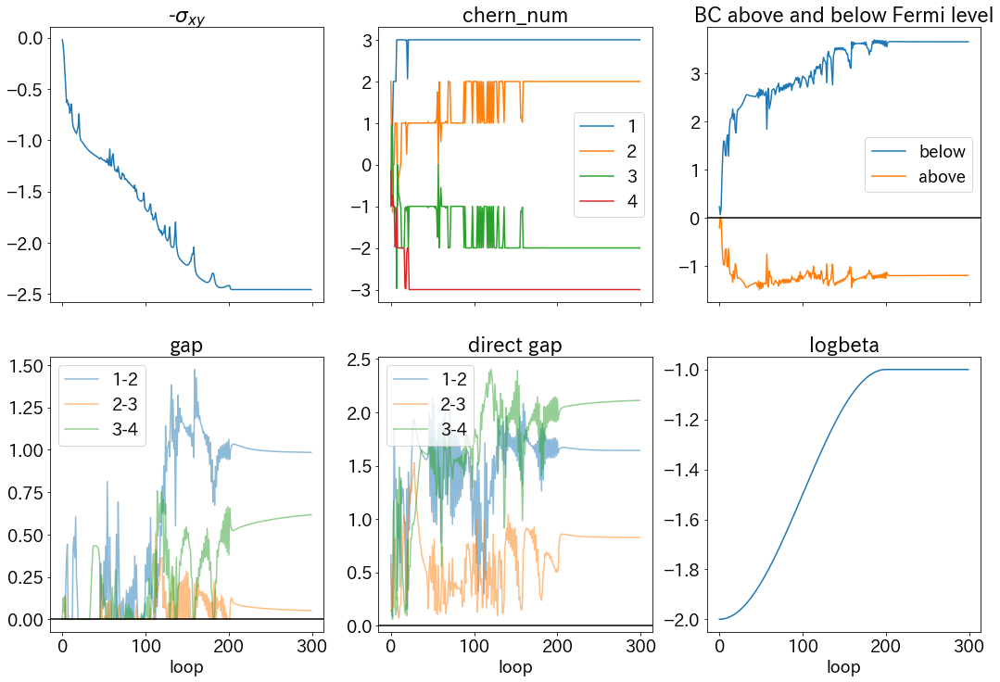

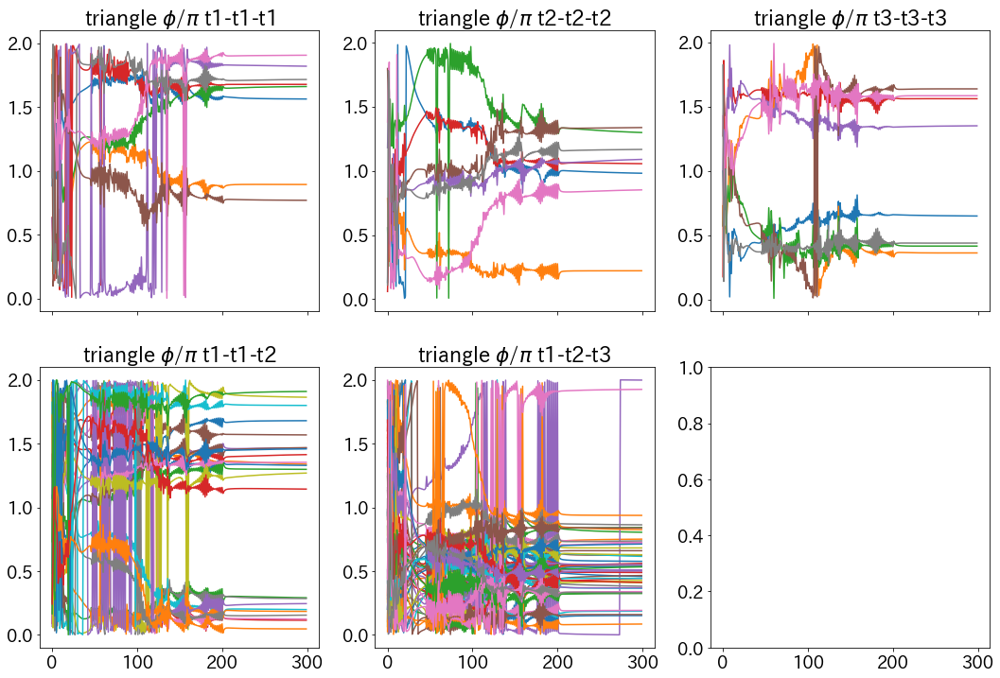

4.999827166080697 [ 2.99999721  1.99993878 -1.99993861 -2.99999738] 1.9999999999972222 -0.52768731039135
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


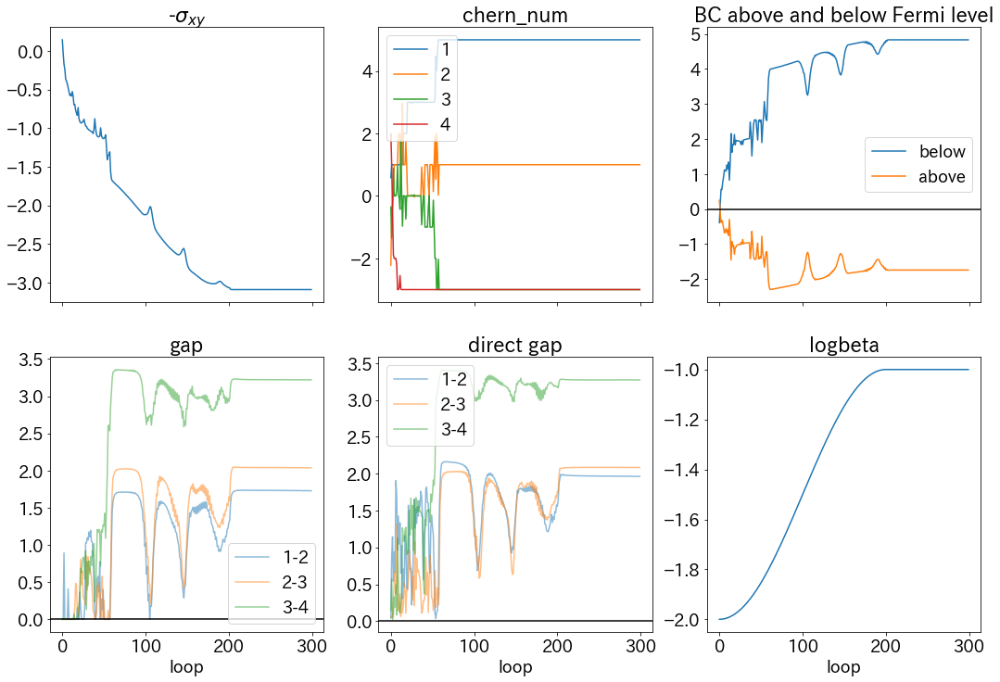

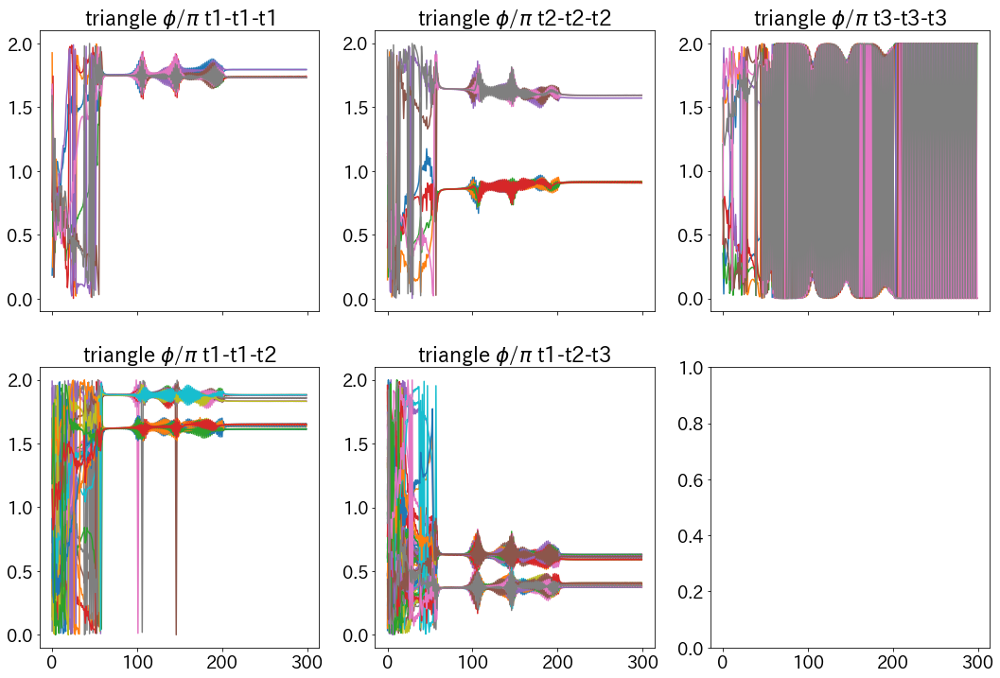

5.999986960872466 [ 4.99998311  1.00000385 -2.99998775 -2.99999922] 1.9999999999999987 -1.8748884940698995
CPU times: user 1min 29s, sys: 1.05 s, total: 1min 30s
Wall time: 1min 19s


In [47]:
%%time
list_res = []
for seed in [111,222]:
    logger = {}
    filling = jnp.array(2.0)
    step_init = 0 if logger == {} else len(logger['logbeta'])
    xs = {'step': step_init + jnp.arange(num_steps), 'logbeta': logbetas}
    
    boundaries = [200]
    values = [0.1,0.03]
    func_step_size = optimizers.piecewise_constant(boundaries, values)
    opt_init, opt_update, get_params = optimizers.rmsprop(func_step_size, gamma=0.99)
    opt_state = opt_init(get_initial(seed))

    opt_state, logger_tmp = train(xs, opt_state, k, from_d, to_d, allow_d, delta, filling, t_cond, dic_idx_tri, step_size)
    logger = cat_logger(logger, logger_tmp)

    plot_logger(logger)
    plot_logger_t(logger)

    beta = jnp.array(200)
    delta = jnp.array(0.01)
    e,v,sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y = calc_result(beta, delta, opt_state, k, from_d, to_d, allow_d, t_cond, filling)
    print(sigma_xy.sum().real/n_k/n_k, chern_num, n_fill, mu)

    save_results(opt_state, logger, text_condition, seed)

dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


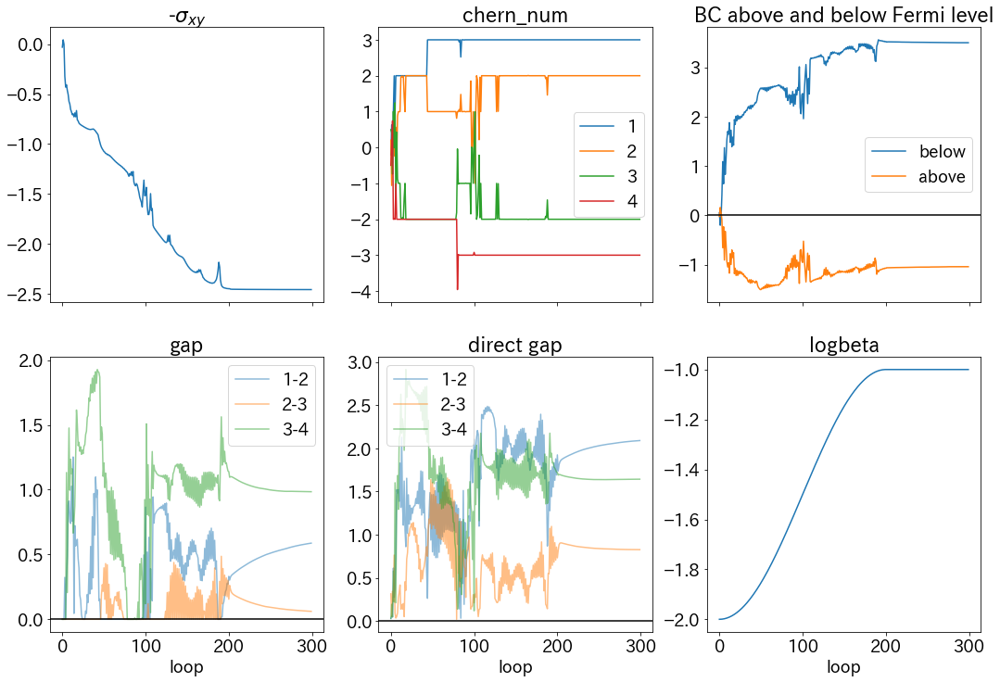

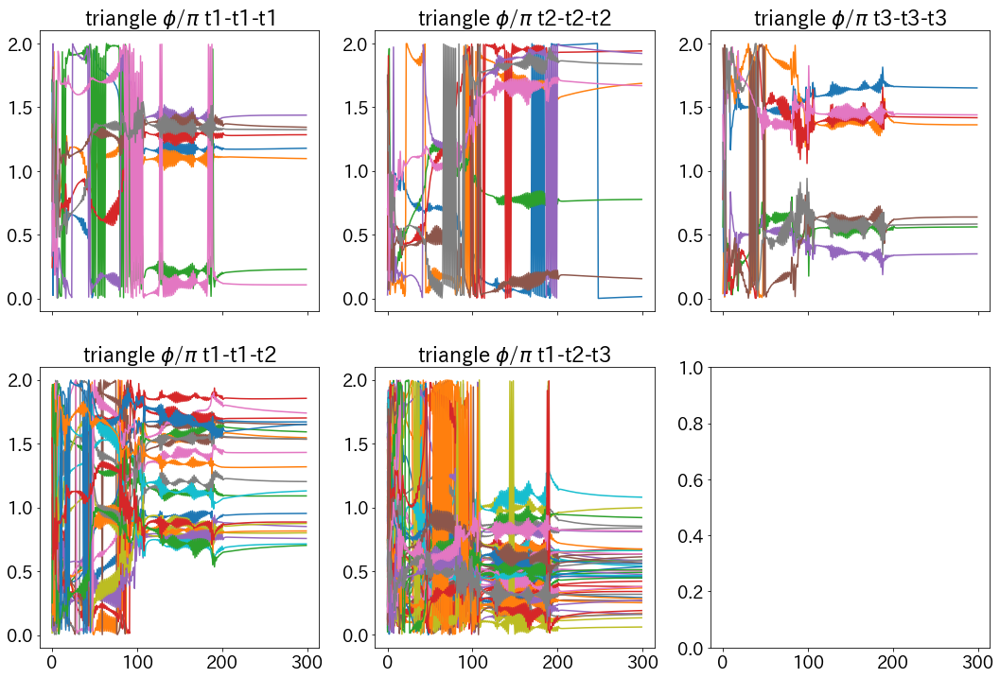

4.999906966878225 [ 2.99999734  1.99993967 -1.99993981 -2.9999972 ] 2.0000000000005205 0.5272561602365564
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


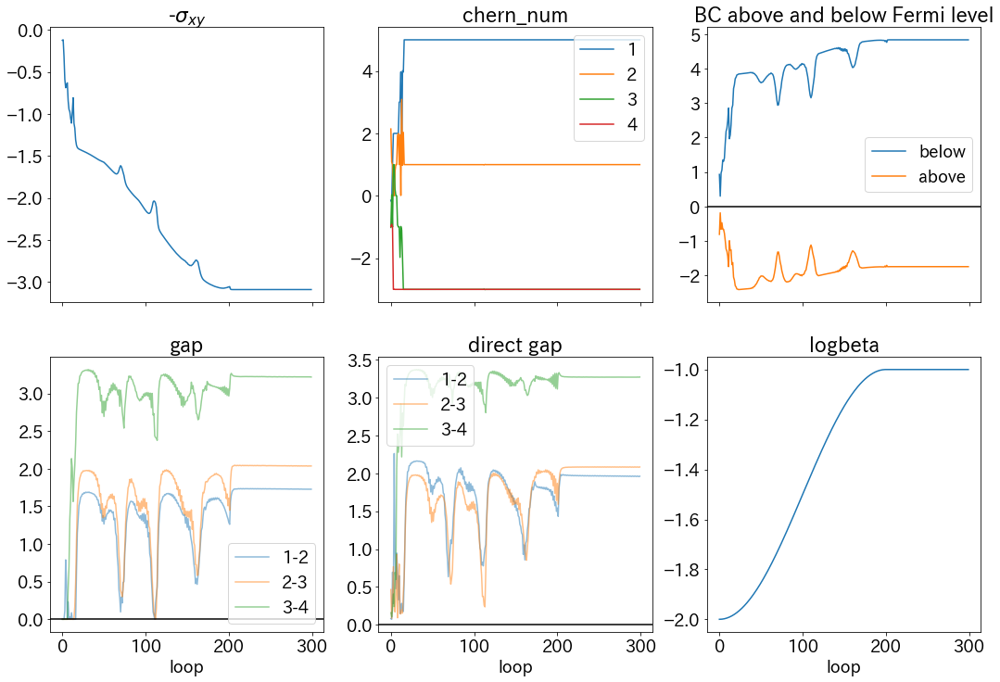

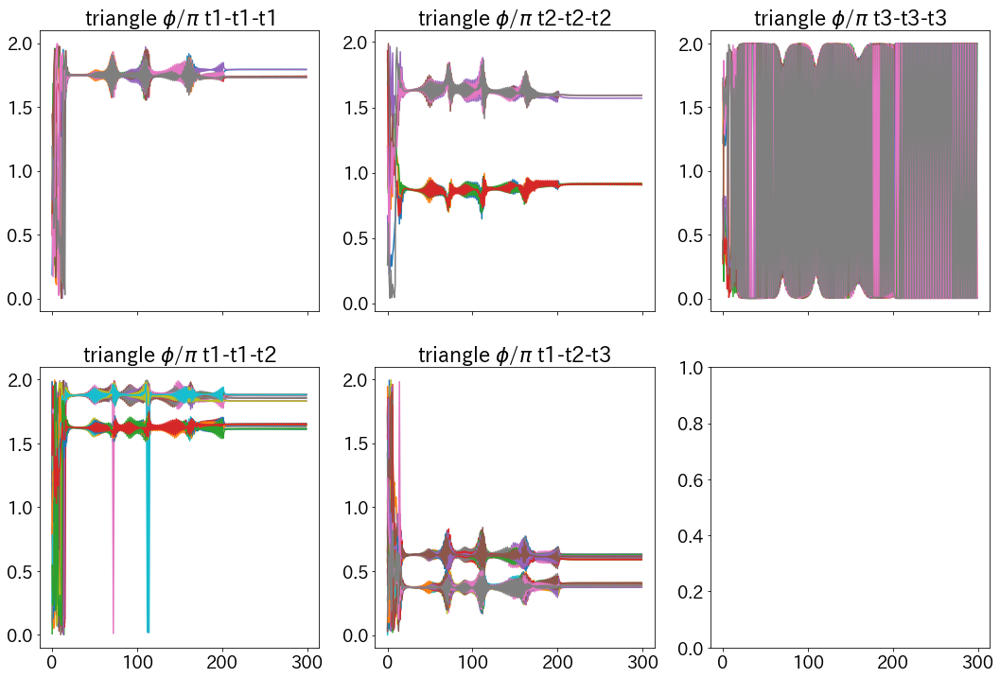

5.999986954360313 [ 4.99998311  1.00000384 -2.99998774 -2.99999922] 1.9999999999999998 -1.8663962139458263
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


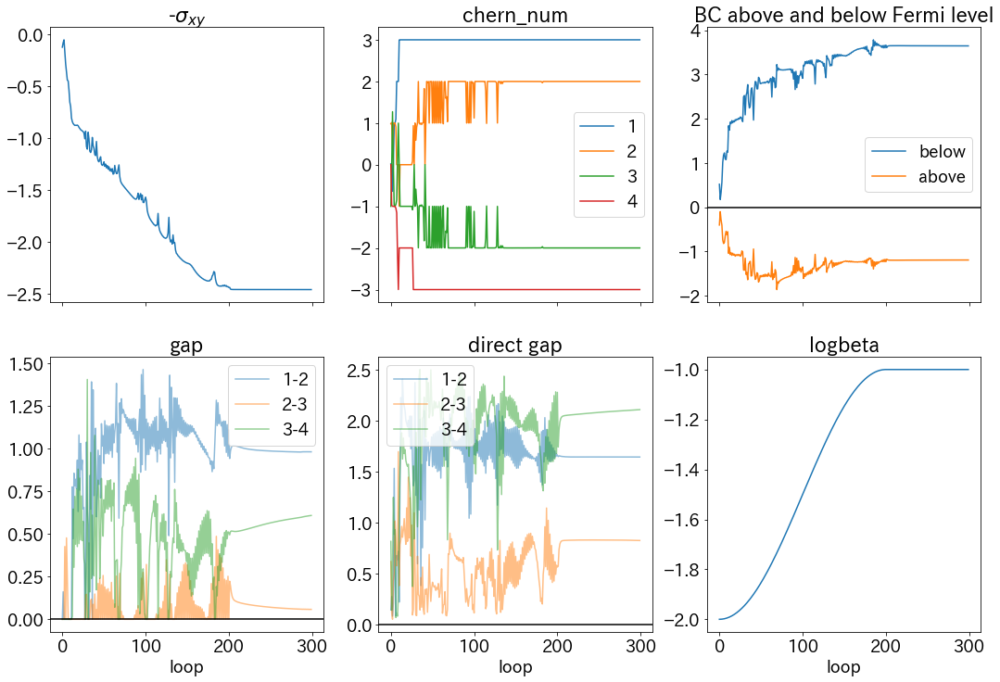

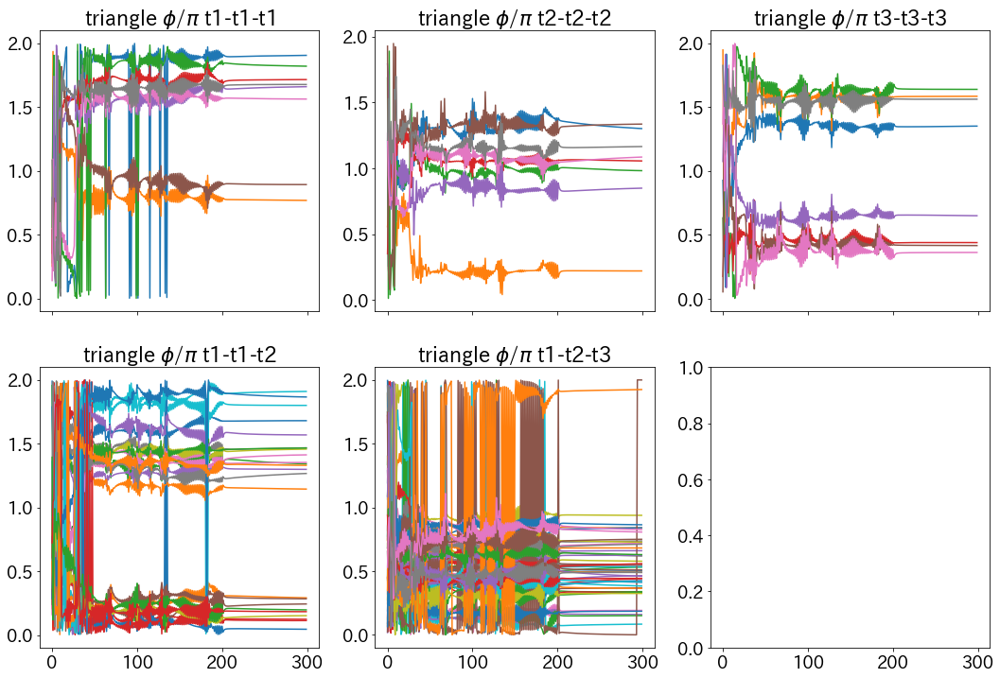

4.999868882262053 [ 2.9999972   1.99993892 -1.99993875 -2.99999737] 2.0000000000006706 -0.5296526303222454
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


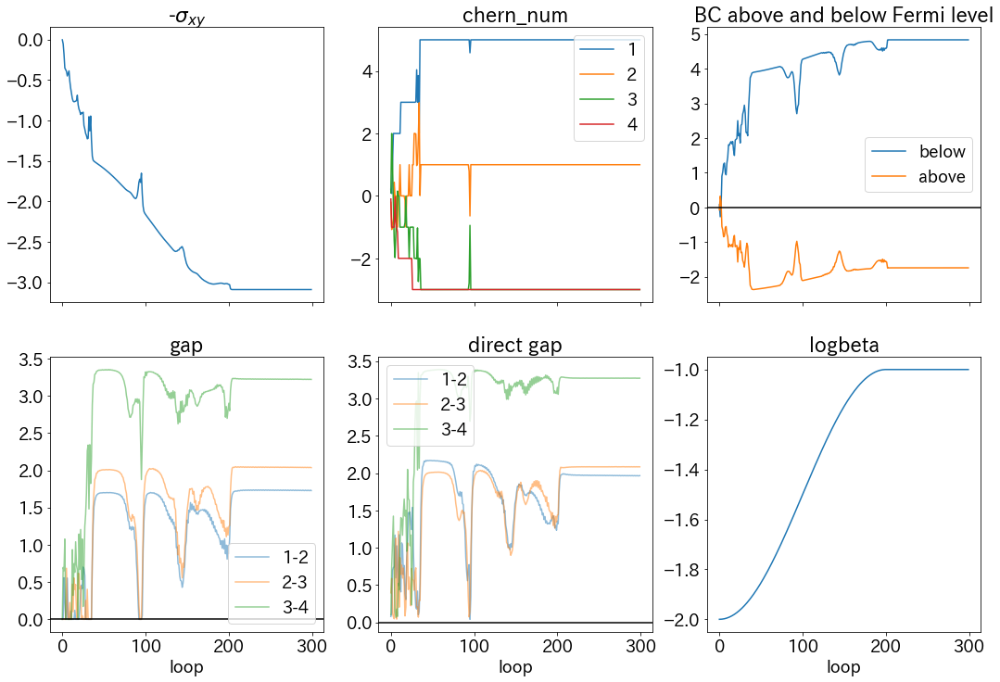

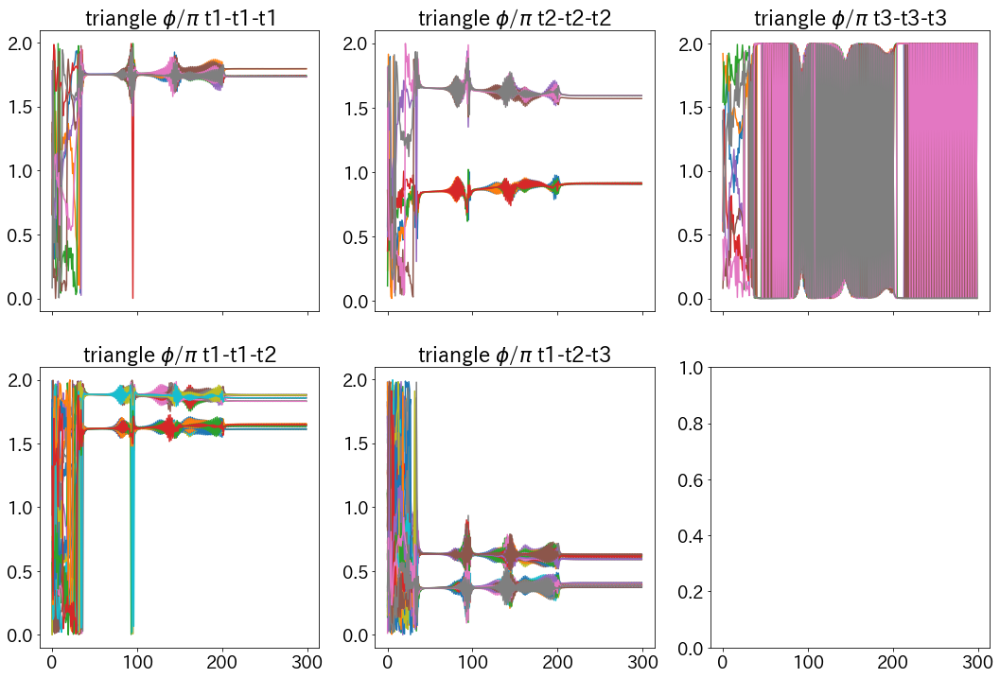

5.9999869564509245 [ 4.99998311  1.00000384 -2.99998774 -2.99999921] 1.9999999999999993 -1.8741216829825984
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


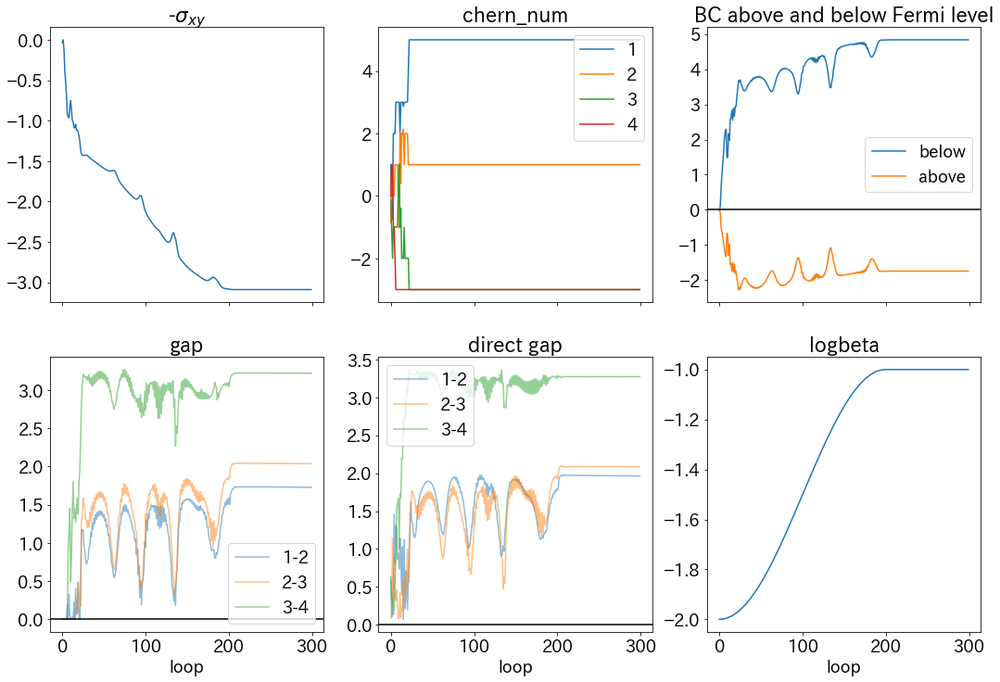

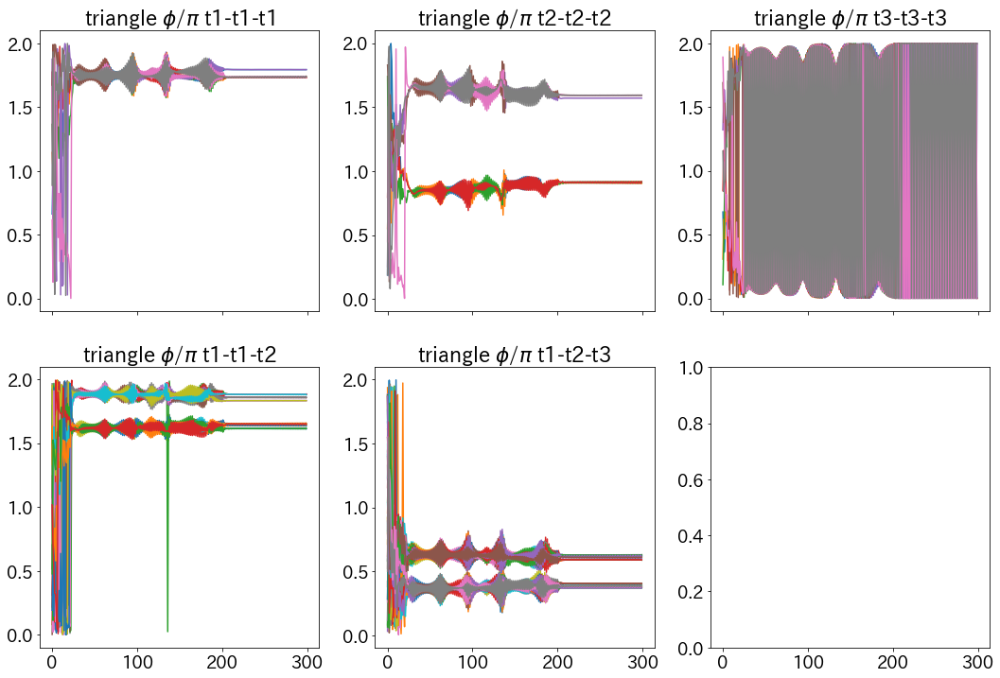

5.999986961196678 [ 4.99998312  1.00000385 -2.99998775 -2.99999922] 1.9999999999999998 -1.8672119895754442
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


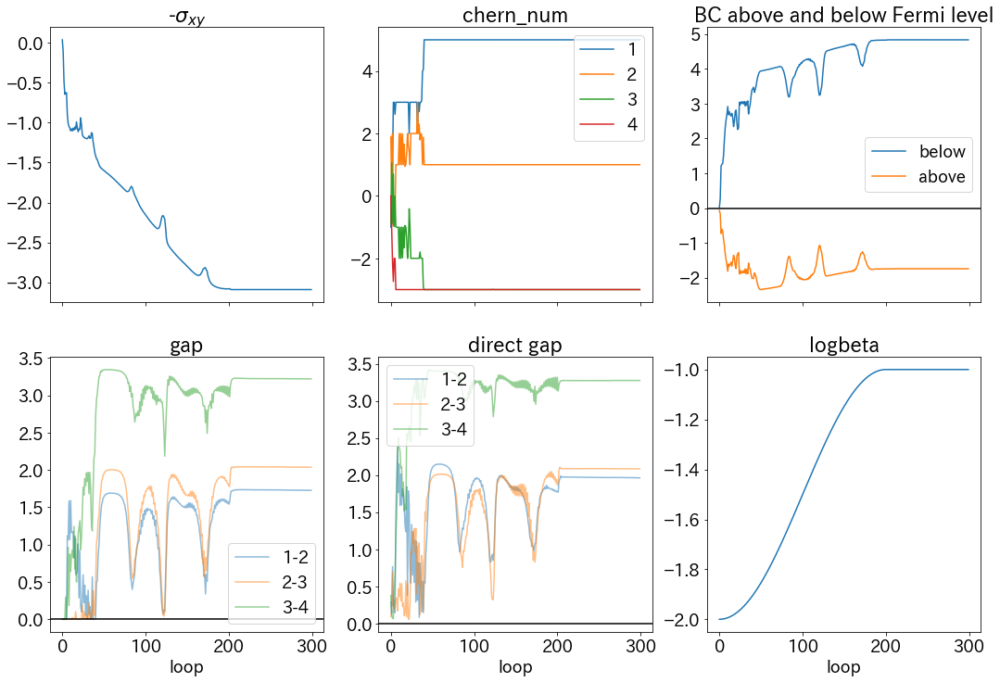

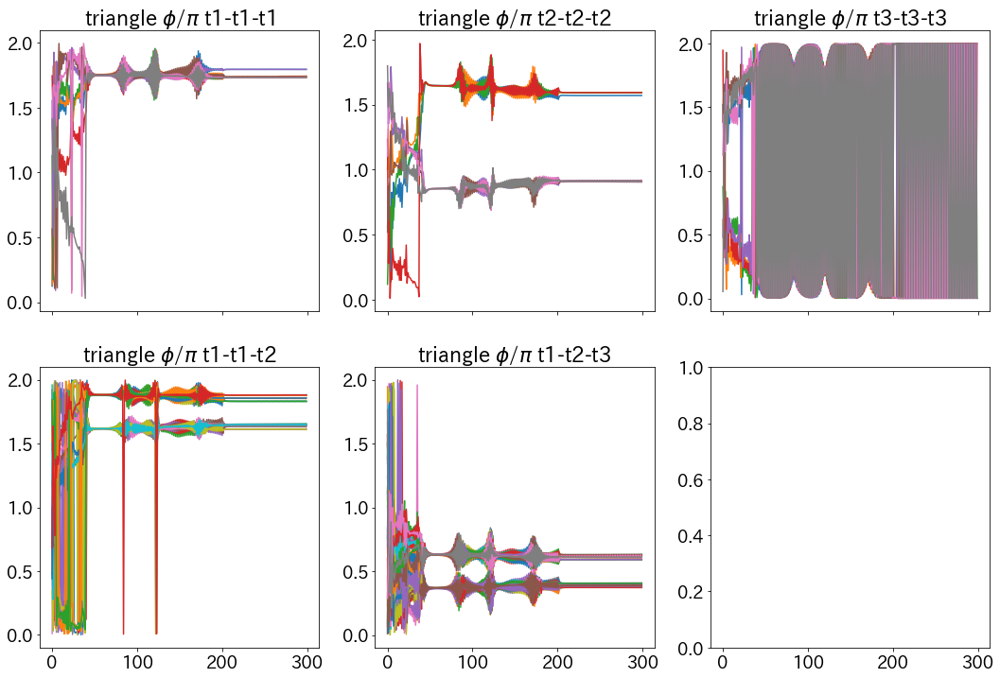

5.999986958131192 [ 4.99998313  1.00000383 -2.99998774 -2.99999922] 1.9999999999999998 -1.8707358055305803
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


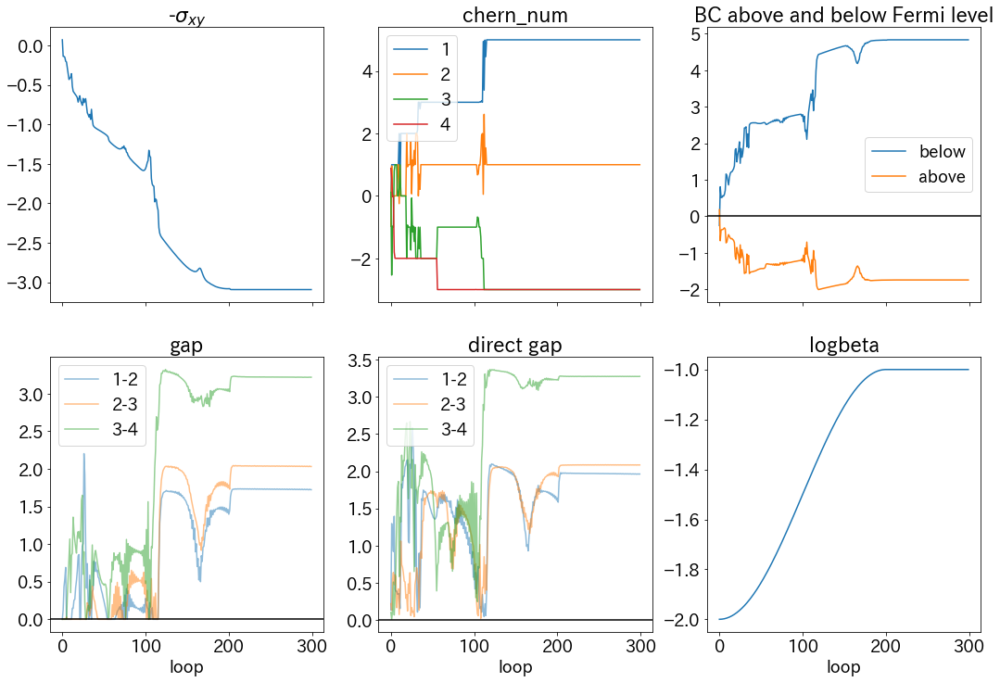

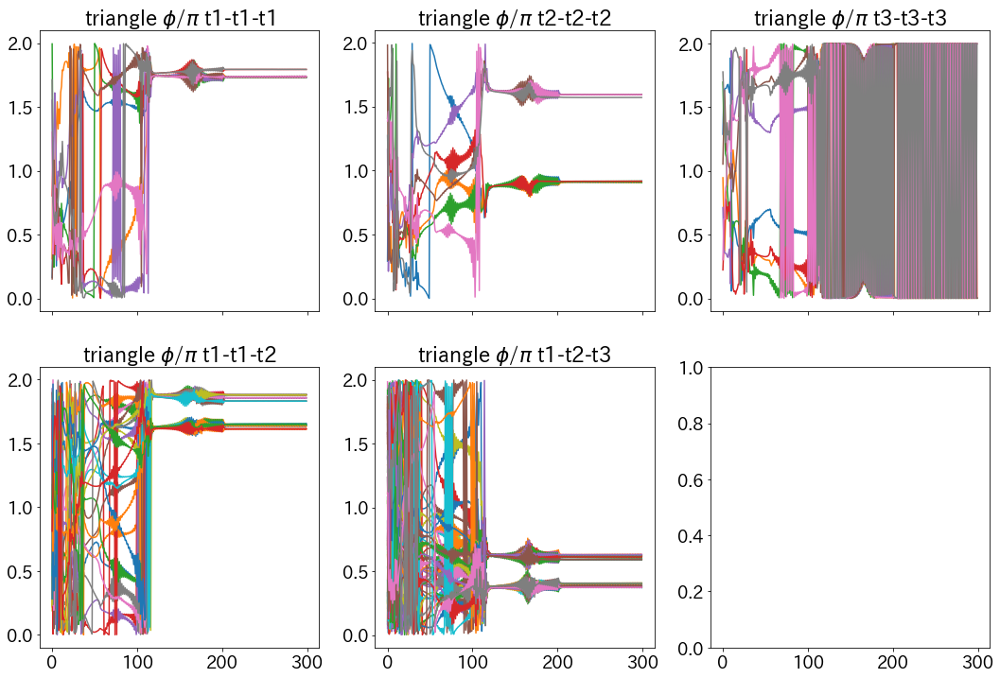

5.99998695462769 [ 4.99998311  1.00000384 -2.99998774 -2.99999922] 1.999999999999998 -1.8772696654909202
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


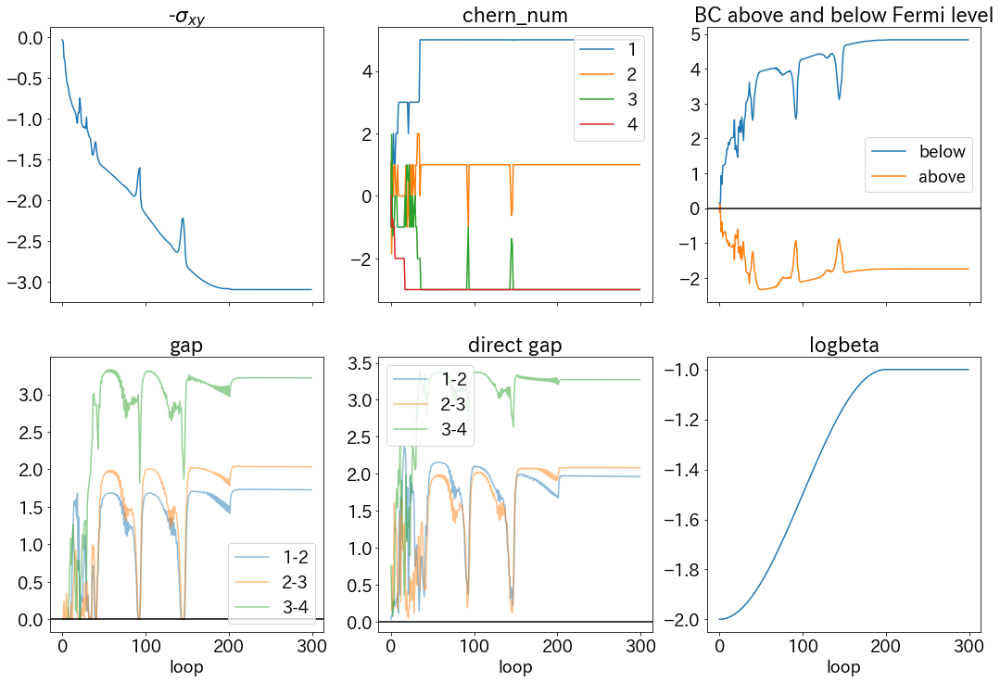

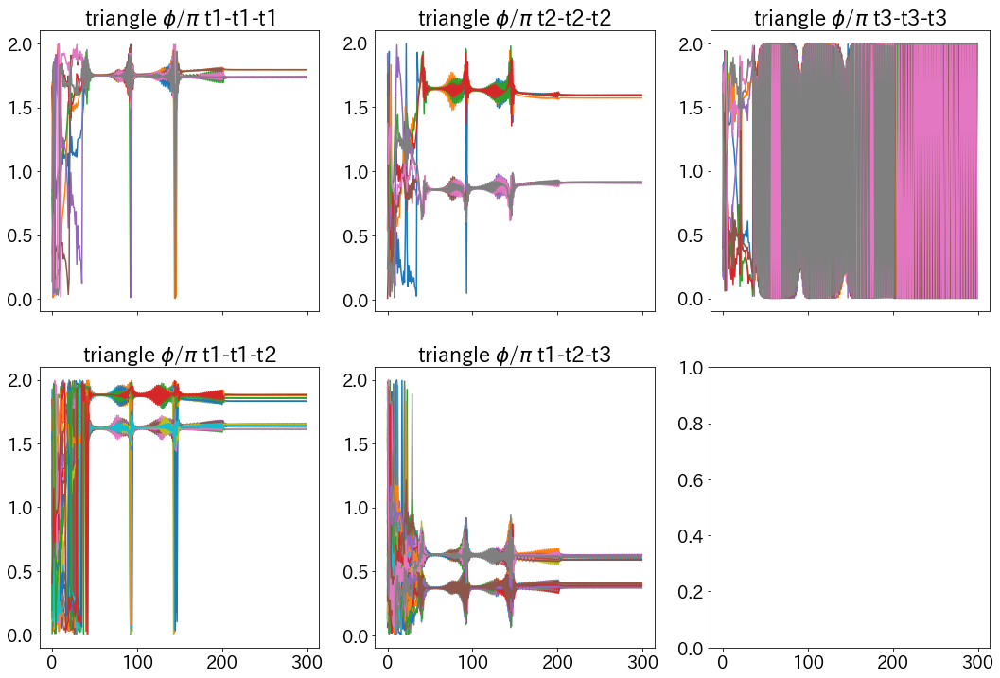

5.999986953077377 [ 4.99998312  1.00000383 -2.99998774 -2.99999922] 1.9999999999999998 -1.8660910286255143
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


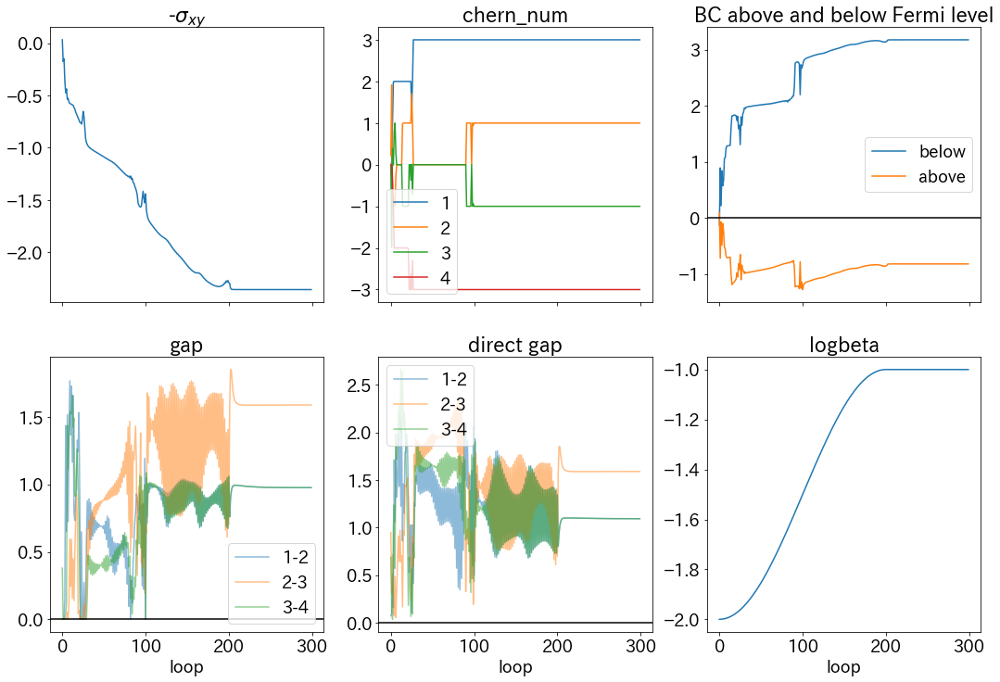

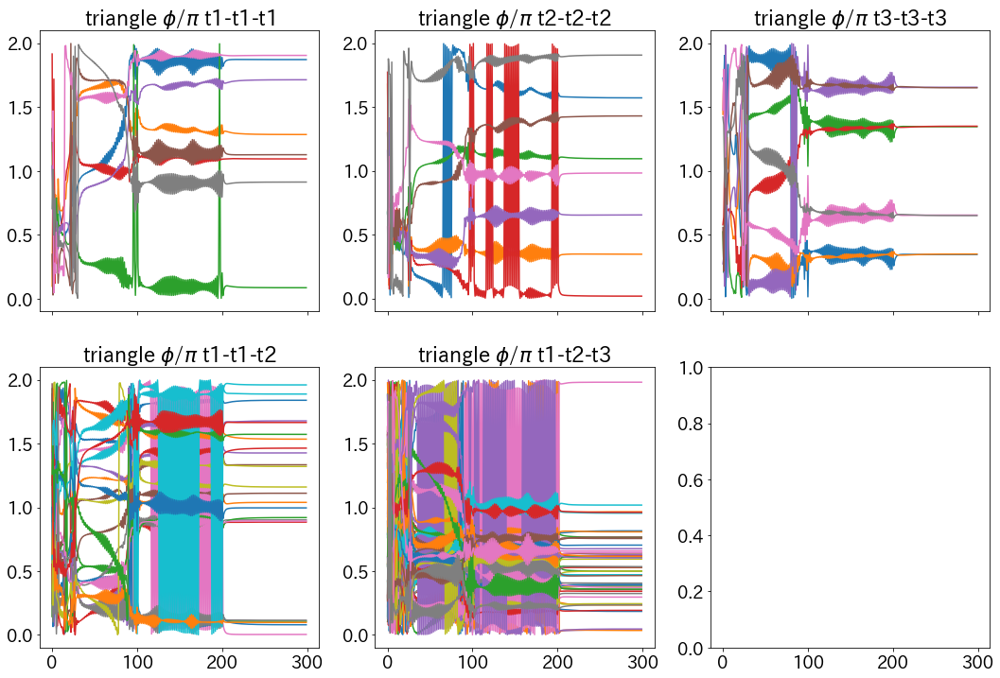

3.9999929713930475 [ 2.99999055  1.00000242 -1.00000242 -2.99999055] 1.9999999999999998 -0.6577224519915121
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


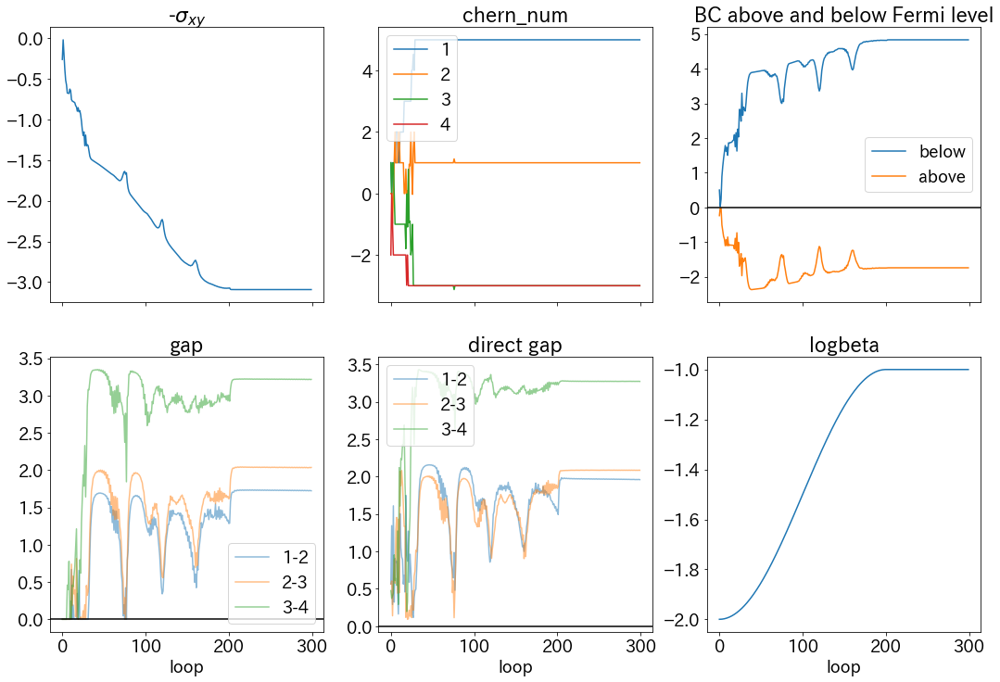

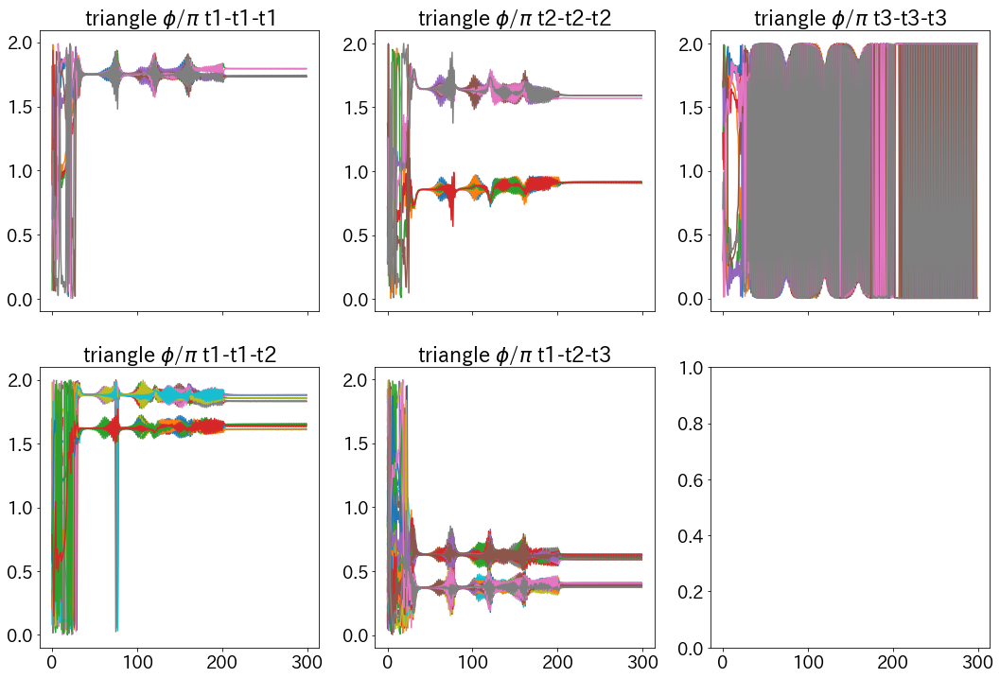

5.999986962205665 [ 4.99998311  1.00000385 -2.99998775 -2.99999922] 1.9999999999999998 -1.8665386073205035
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


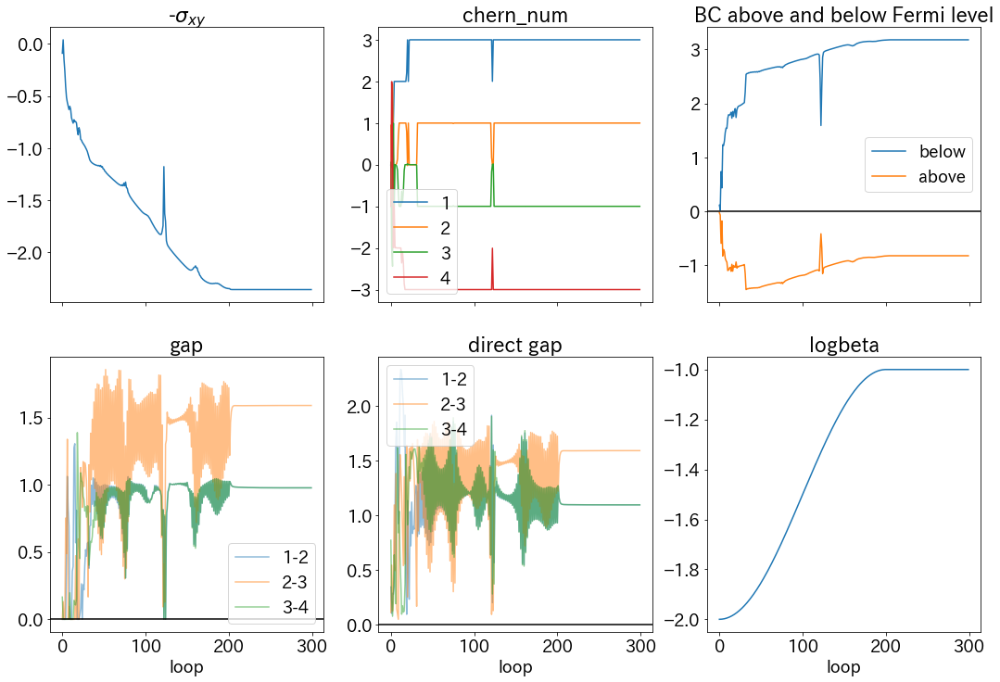

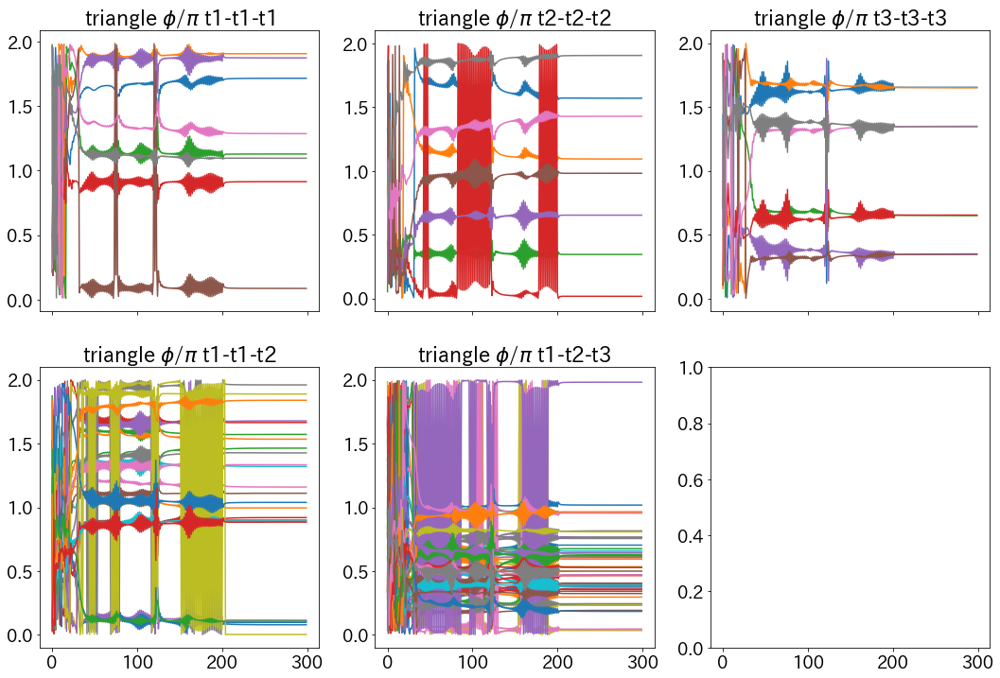

3.9999929708242807 [ 2.99999055  1.00000242 -1.00000242 -2.99999055] 2.0 -0.6583136962859637
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


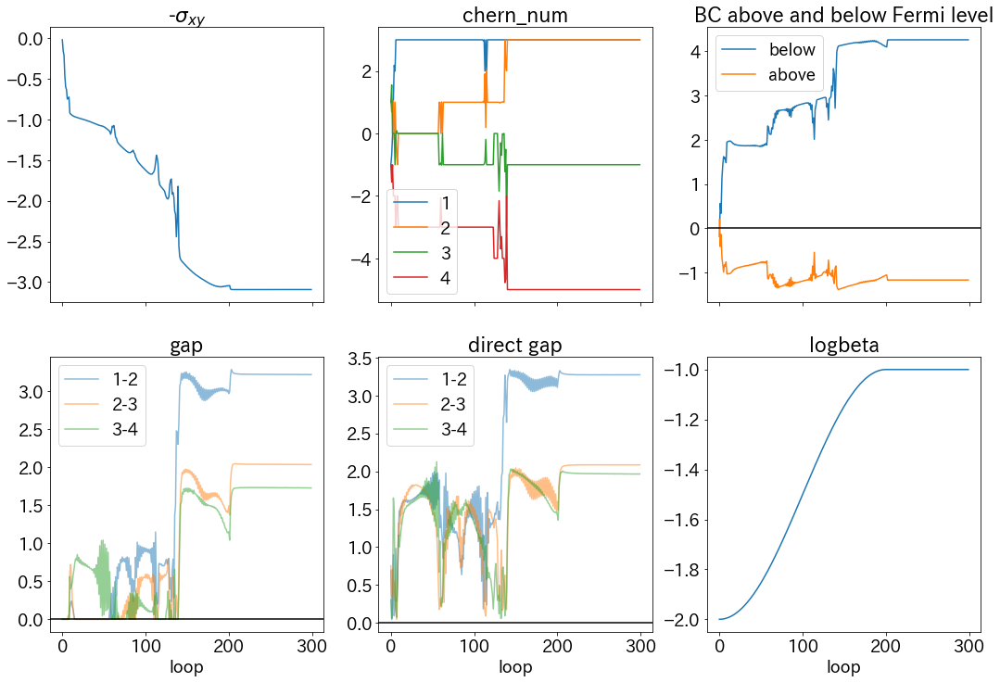

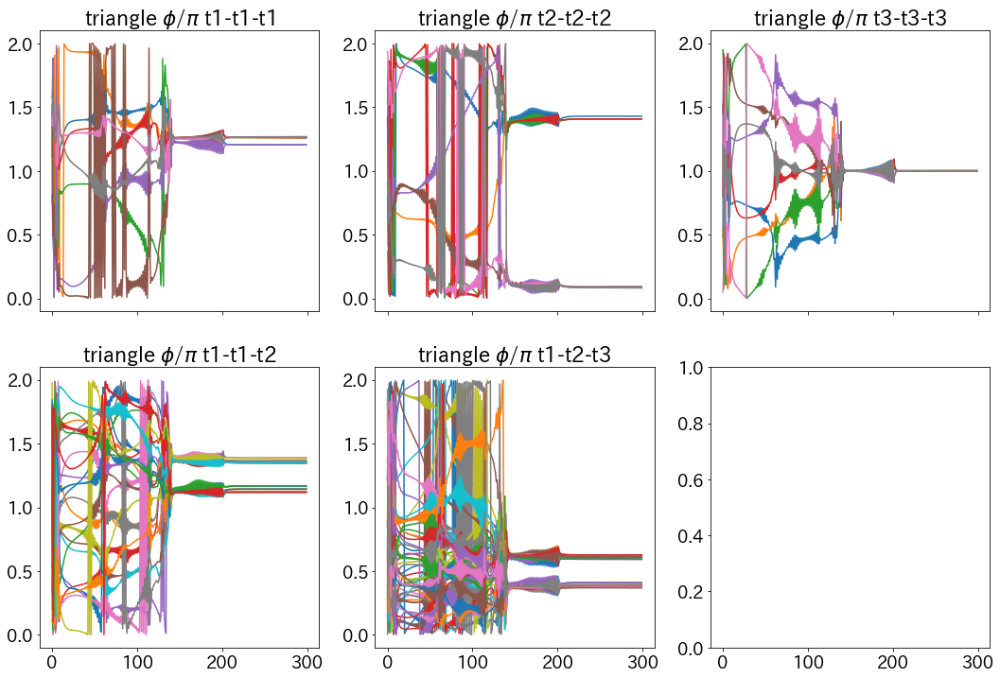

5.999986959669764 [ 2.99999922  2.99998774 -1.00000384 -4.99998312] 1.9999999999999998 0.11339969027803615
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


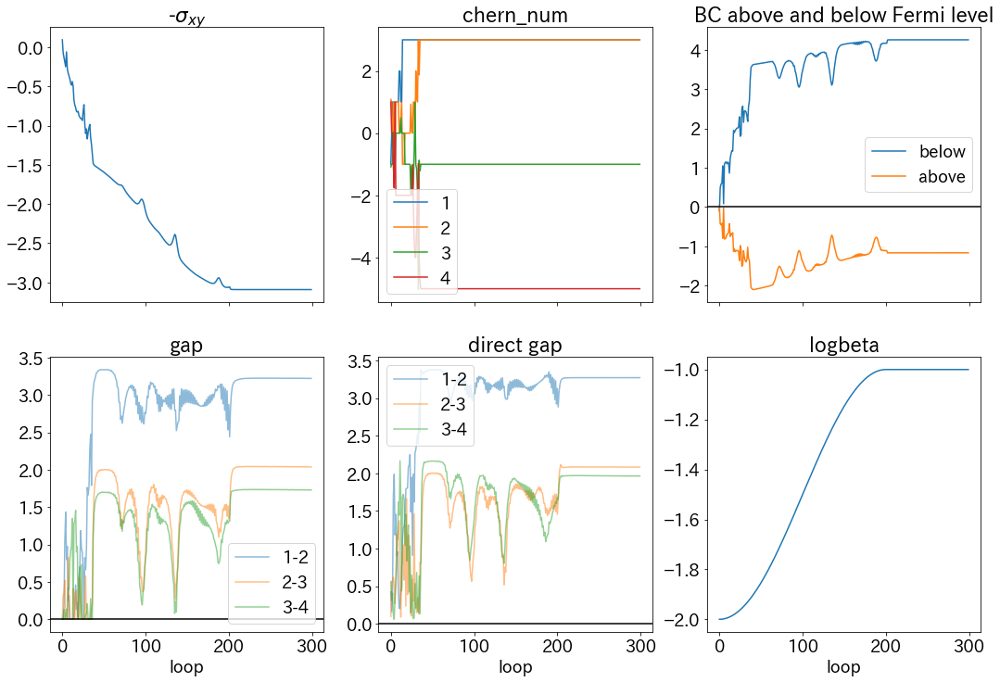

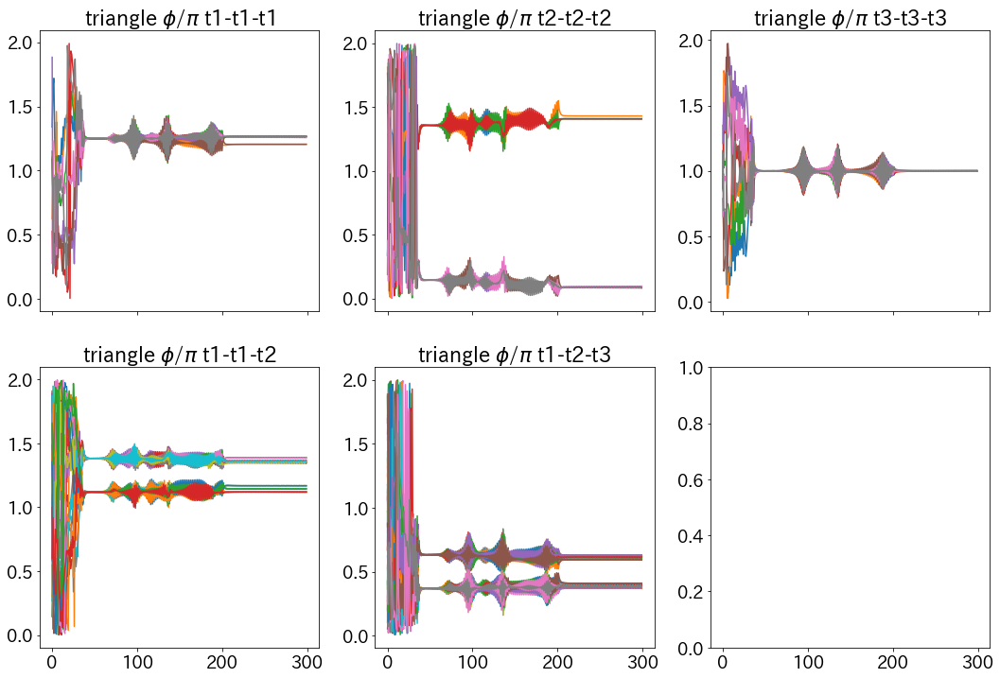

5.99998695338066 [ 2.99999921  2.99998774 -1.00000385 -4.99998311] 1.9999999999999998 0.11316899368236641
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


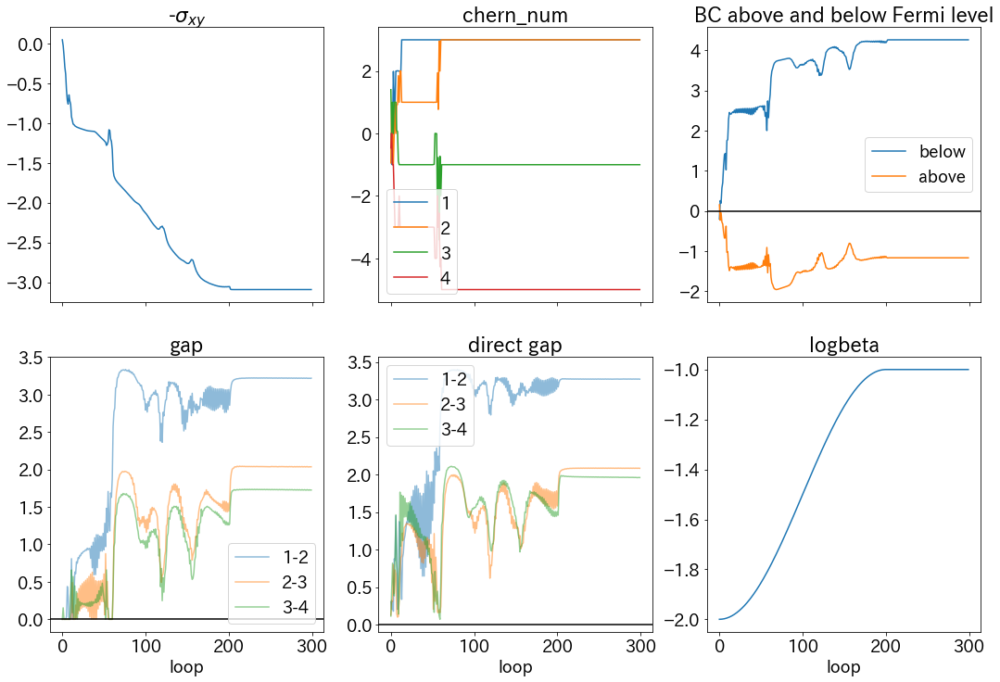

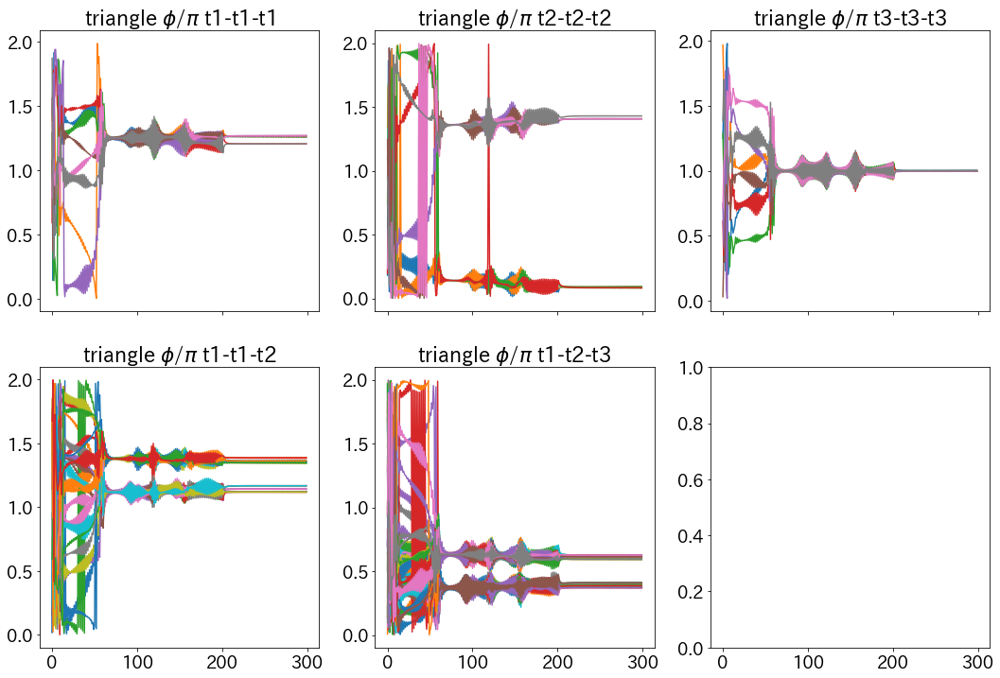

5.999986953345032 [ 2.99999922  2.99998774 -1.00000384 -4.99998311] 2.0 0.11152758033291225
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


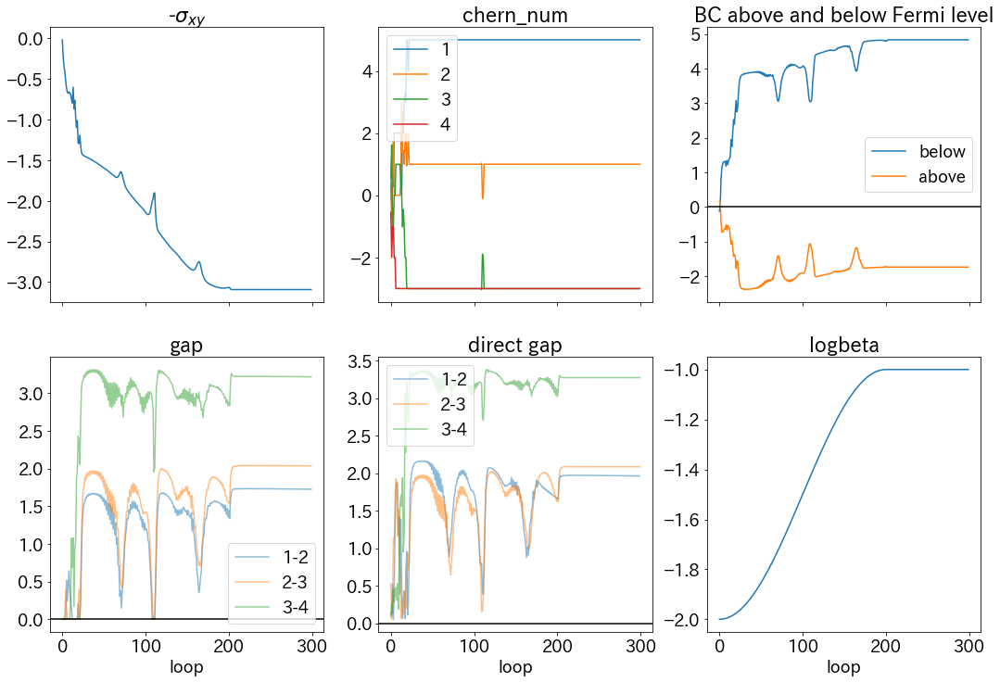

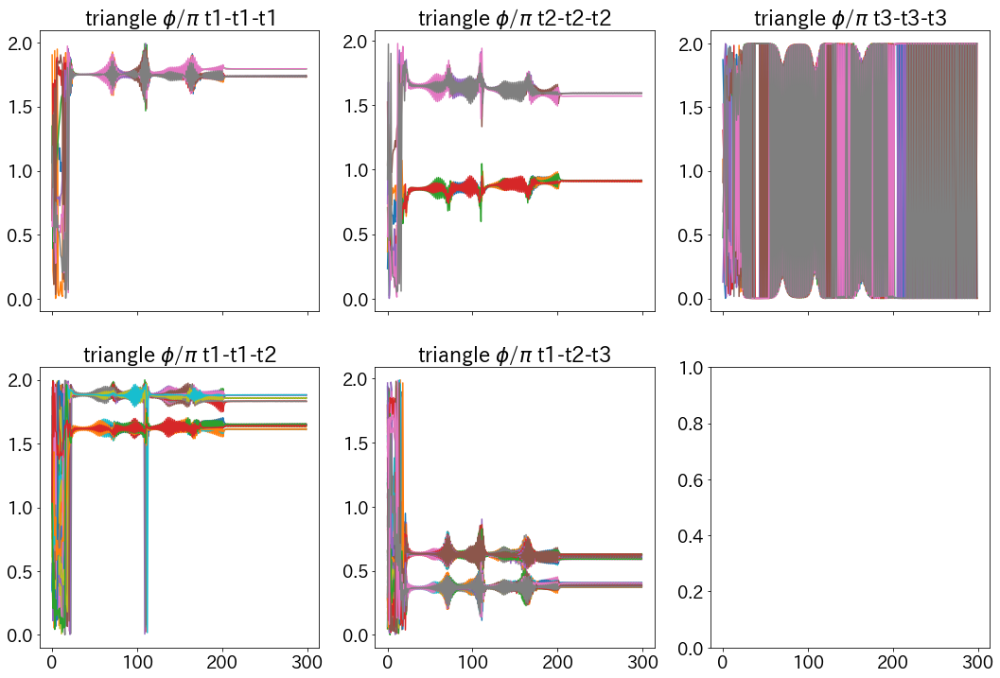

5.999986955023535 [ 4.99998312  1.00000384 -2.99998774 -2.99999922] 1.9999999999999998 -1.868069992704644
dict_keys(['bc_fm_above', 'bc_fm_below', 'bc_fm_nega', 'bc_fm_posi', 'chern_num', 'gaps', 'gaps_direct', 'grads', 'logbeta', 'n_fm', 'param', 'sigma_xy', 'tri_phase', 'tri_weight'])


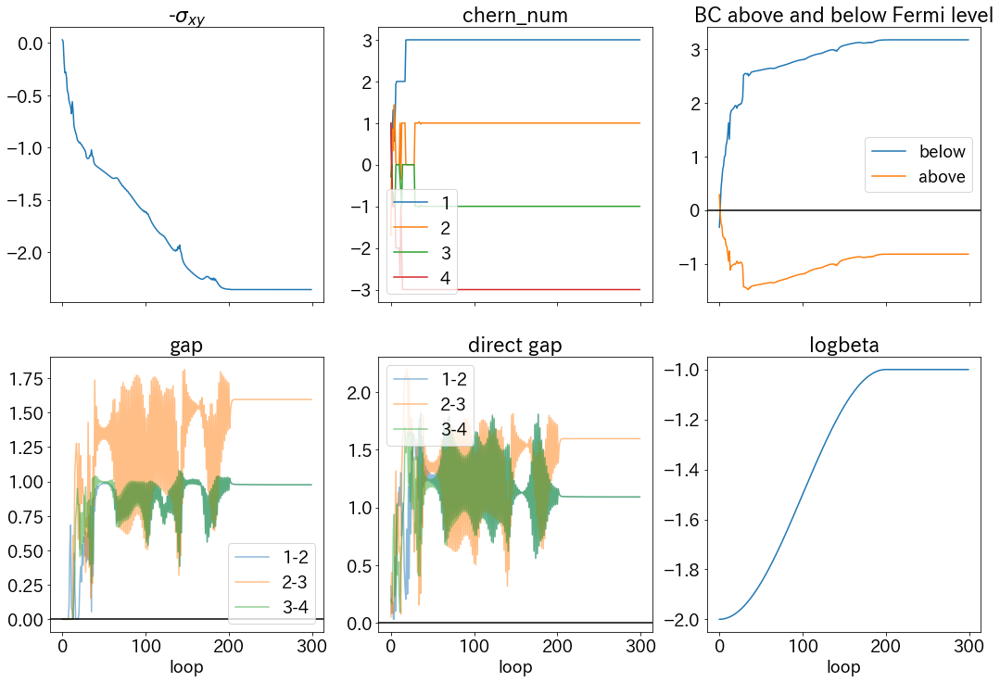

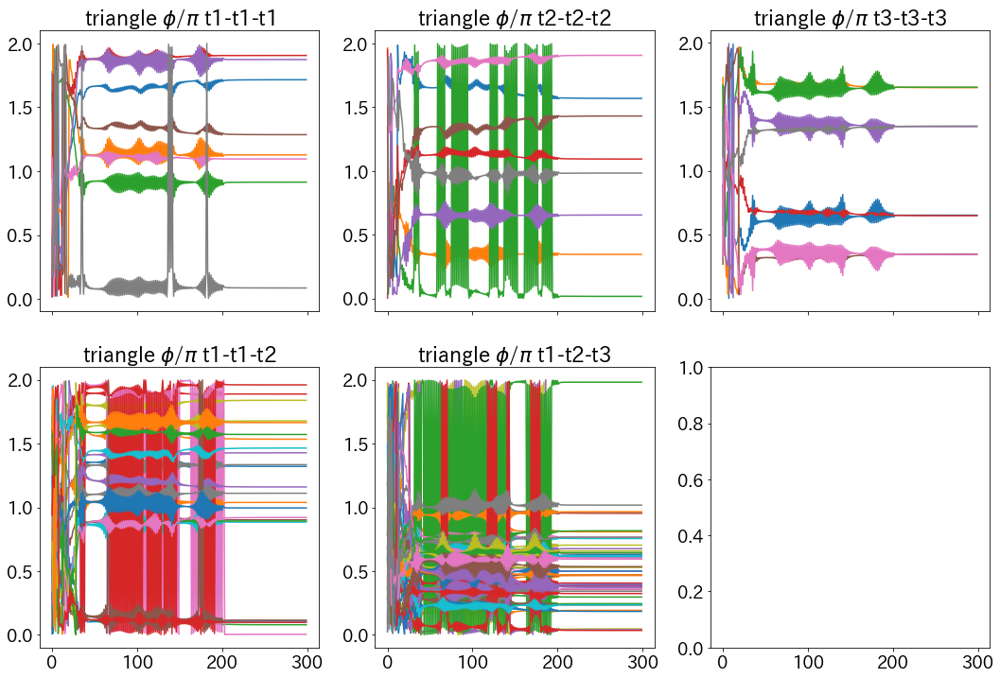

3.999992967529993 [ 2.99999053  1.00000244 -1.00000244 -2.99999053] 2.0 -0.6591773495400186
CPU times: user 11min 47s, sys: 8.49 s, total: 11min 55s
Wall time: 10min 33s


In [48]:
%%time
list_res = []
for seed in [333,444,555,666,777,888,999,1111,2222,3333,4444,5555,6666,7777,8888,9999]:
    logger = {}
    filling = jnp.array(2.0)
    step_init = 0 if logger == {} else len(logger['logbeta'])
    xs = {'step': step_init + jnp.arange(num_steps), 'logbeta': logbetas}
    
    boundaries = [200]
    values = [0.1,0.03]
    func_step_size = optimizers.piecewise_constant(boundaries, values)
    opt_init, opt_update, get_params = optimizers.rmsprop(func_step_size, gamma=0.99)
    opt_state = opt_init(get_initial(seed))

    opt_state, logger_tmp = train(xs, opt_state, k, from_d, to_d, allow_d, delta, filling, t_cond, dic_idx_tri, step_size)
    logger = cat_logger(logger, logger_tmp)

    plot_logger(logger)
    plot_logger_t(logger)

    beta = jnp.array(200)
    delta = jnp.array(0.01)
    e,v,sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y = calc_result(beta, delta, opt_state, k, from_d, to_d, allow_d, t_cond, filling)
    print(sigma_xy.sum().real/n_k/n_k, chern_num, n_fill, mu)

    save_results(opt_state, logger, text_condition, seed)

# Figure

In [49]:
import seaborn as sns
sns.set()
sns.set_style("whitegrid", {'grid.linestyle': '-'})
sns.set_context("paper", 2.0, {"lines.linewidth": 3, 'font.size': 9}) # これでフォントが9*2=18になっているはず？ : https://stackoverflow.com/questions/36220829/fine-control-over-the-font-size-in-seaborn-plots-for-academic-papers/36222162

from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
import matplotlib.patches as patches
from matplotlib.transforms import Bbox

## main

In [50]:
def my_color(ii):
    """
    hexade
    base: RGB:79,84,208
    """
    c_h, c_s, c_v = colorsys.rgb_to_hsv(79.0/255, 84.0/255, 208.0/255)
    return colorsys.hsv_to_rgb((c_h+ii*1.0/8)%1.0, c_s, c_v)

c_h, c_s, c_v = colorsys.rgb_to_hsv(79.0/255, 84.0/255, 208.0/255)

In [51]:
text_condition = f'triangular'
seed = 222
opt_state, logger = load_results(text_condition, seed)
boundaries = [200]
values = [0.1,0.03]
func_step_size = optimizers.piecewise_constant(boundaries, values)
opt_init, opt_update, get_params = optimizers.rmsprop(func_step_size, gamma=0.99)
params = get_params(opt_state)

In [52]:
beta = jnp.array(200)
delta = jnp.array(0.01)
filling = jnp.array(2.0)
e,v,sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y = calc_result(beta, delta, opt_state, k, from_d, to_d, allow_d, t_cond, filling)
print(sigma_xy.sum().real/n_k/n_k, chern_num, n_fill, mu)
t_res = calc_t(get_params(opt_state), t_cond)

5.999986960872466 [ 4.99998311  1.00000385 -2.99998775 -2.99999922] 1.9999999999999987 -1.8748884940698995


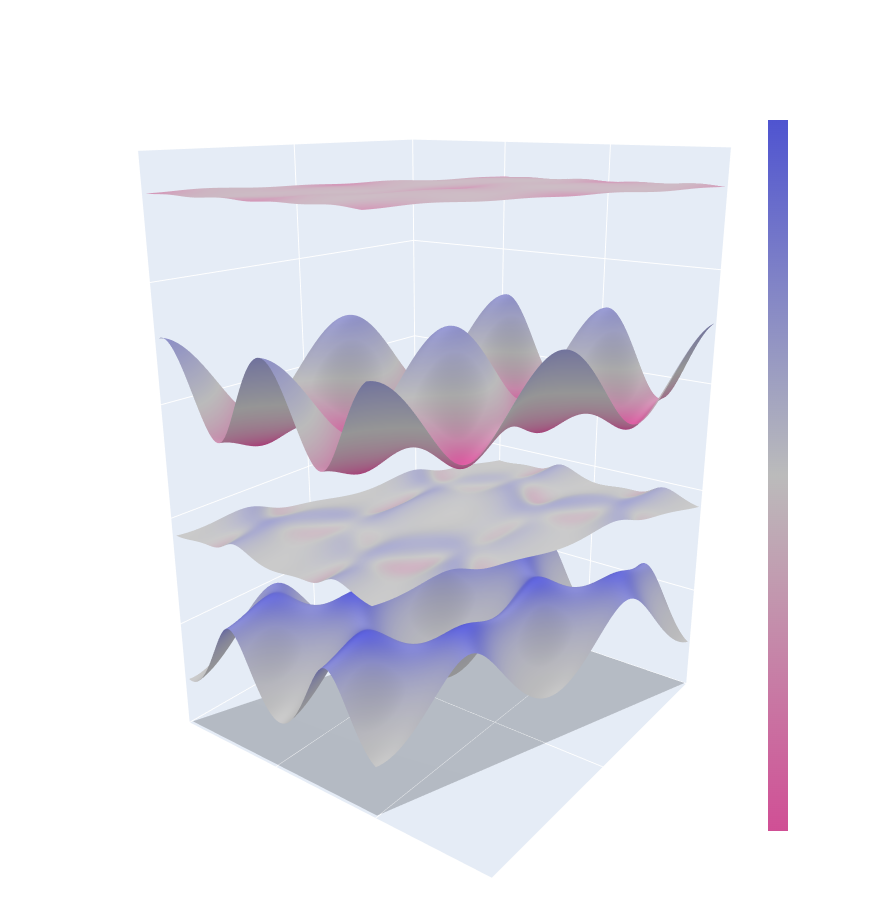

In [53]:
colorscale = [[0, '#D04F95'],[0.5, '#BBBBBB'], [1, '#4F54D0']] # 'RdBu'
colorscale2 = [[0, '#A6ACB5'], [1, '#A6ACB5']] # #E6ECF5
fig = go.Figure(data=[go.Surface(x=k[:,:,0], y=k[:,:,1], z=e[:,:,0]-mu, surfacecolor=omegaz[:,:,0].real, cmax=15, cmin=-15, colorscale=colorscale, reversescale=False,  colorbar={'len': 0.85, 'thickness': 20, 'tickvals': [], 'x': 0.85, 'y': 0.47}), #'tickfont': {'family': "DejaVu Sans"} 
                      go.Surface(x=k[:,:,0], y=k[:,:,1], z=e[:,:,1]-mu, surfacecolor=omegaz[:,:,1].real, cmax=15, cmin=-15, colorscale=colorscale, reversescale=False, showscale=False), 
                      go.Surface(x=k[:,:,0], y=k[:,:,1], z=e[:,:,2]-mu, surfacecolor=omegaz[:,:,2].real, cmax=15, cmin=-15, colorscale=colorscale, reversescale=False, showscale=False), 
                      go.Surface(x=k[:,:,0], y=k[:,:,1], z=e[:,:,3]-mu, surfacecolor=omegaz[:,:,3].real, cmax=15, cmin=-15, colorscale=colorscale, reversescale=False, showscale=False), 
                      go.Surface(x=k[:,:,0], y=k[:,:,1], z=jnp.ones_like(e[:,:,0])*-5.999, surfacecolor=jnp.zeros_like(omegaz[:,:,3].real), cmax=15, cmin=-15, colorscale=colorscale2, reversescale=False, showscale=False),                       
                     ])
fig.update_layout(autosize=False,  width=1100, height=900, 
                  scene_camera=dict(eye=dict(x=2.4*0.85, y=1.8*0.85, z=1.0*0.85)), 
                  scene_aspectmode='manual', scene_aspectratio=dict(x=1,y=1,z=1.5),
                  scene_xaxis=dict(title = '', tickmode='array', tickvals=[0, np.pi/2, np.pi], ticktext=['','',''], range=[0, np.pi]), 
                  scene_yaxis=dict(title = '', tickmode='array', tickvals=[-np.pi/np.sqrt(3), 0, np.pi/np.sqrt(3), 2*np.pi/np.sqrt(3)], ticktext=['','','', ''], range=[-np.pi/np.sqrt(3), 2*np.pi/np.sqrt(3)]), 
                  scene_zaxis=dict(title = '', tickmode='array', tickvals=[-6,-3,0,3,6,9], ticktext=['','','','','',''], range=[-6,9]), 
                  margin=dict(l=0, r=0, b=20, t=20),
                  font_family="DejaVu Sans", 
                  font_size=16,
                  )

fig.show()
fig.write_image('figure/band.pdf')
fig.write_image('figure/band.png', scale=1)

In [54]:
a0 = a[0]
a1 = a[1]
a2 = a[1] - a[0]

_n = 20
_ar = np.arange(-_n/2,_n/2)
_ar1, _ar2 = np.meshgrid(_ar,_ar)
Rs = R[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + R[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
Rs = Rs.reshape(-1,2)

points = a[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + a[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
points = points.reshape(-1,2)


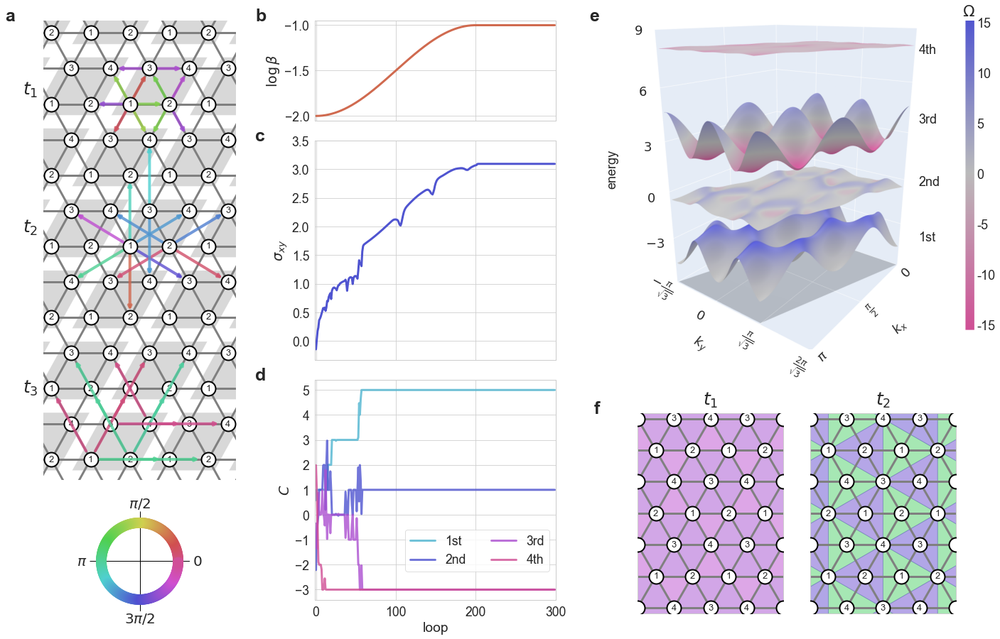

In [55]:
figure = plt.figure(figsize=(24, 15))
gs_master = GridSpec(nrows=5, ncols=3, height_ratios=[1,1,1,1,1], width_ratios=[0.8,1,1.5], hspace=0.6, wspace=0.3)

_x_fig_ind, _y_fig_ind = -0.20, 1.00


#################################################################################################################

gs_1 = GridSpecFromSubplotSpec(nrows=5, ncols=1, subplot_spec=gs_master[0:5, 1:2], hspace=0.2)
ax = figure.add_subplot(gs_1[0:1, 0])
ax.plot(logger['logbeta'], color=my_color(3)) # #D0CB4F #4FD08A 
ax.set_ylabel(r'$\log \beta$')
ax.set_xlim(-1,300)
ax.set_xticklabels([])
ax.text(_x_fig_ind/0.8, _y_fig_ind, "b", transform=ax.transAxes, weight='bold', fontsize=25)


ax = figure.add_subplot(gs_1[1:3, 0])
ax.plot(-logger['sigma_xy'], color=my_color(0))
ax.set_ylabel(r'$\sigma_{xy}$')
ax.set_ylim(-0.33, 3.5)
ax.set_xlim(-1,300)
ax.set_xticklabels([])
ax.text(_x_fig_ind/0.8, _y_fig_ind, "c", transform=ax.transAxes, weight='bold', fontsize=25)


ax = figure.add_subplot(gs_1[3:5, 0])
ax.plot(logger['chern_num'][:,0], label='1st', color=my_color(-1), alpha=0.8)
ax.plot(logger['chern_num'][:,1], label='2nd', color=my_color(0), alpha=0.8)
ax.plot(logger['chern_num'][:,2], label='3rd', color=my_color(1), alpha=0.8)
ax.plot(logger['chern_num'][:,3], label='4th', color=my_color(2), alpha=0.8)
ax.set_ylabel(r'$C$')
ax.legend(ncol=2, loc='lower right', bbox_to_anchor=(1.0,0.1))
#ax.legend(ncol=2, loc=(100, -2))
ax.set_yticks([-3,-2,-1,0,1,2,3,4,5])
ax.set_xlim(-1,300)
ax.set_xlabel('loop')
ax.text(_x_fig_ind/0.8, _y_fig_ind, "d", transform=ax.transAxes, weight='bold', fontsize=25)




#################################################################################################################


gs_2 = GridSpecFromSubplotSpec(nrows=5, ncols=1, subplot_spec=gs_master[0:5, 0:1], hspace=0.2)
ax = figure.add_subplot(gs_2[0:4, :])
ax.text(_x_fig_ind, 1+(_y_fig_ind-1)/3, "a", transform=ax.transAxes, weight='bold', fontsize=25)

a0 = a[0]
a1 = a[1]
a2 = a[1] - a[0]

_n = 20
_ar = np.arange(-_n/2,_n/2)
_ar1, _ar2 = np.meshgrid(_ar,_ar)
points = a[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + a[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
points = points.reshape(-1,2)

for j in range(-10,10):
    ax.plot(np.array([-a0[0],a0[0]])*10+a1[0]*j, np.array([-a0[1],a0[1]])*10+a1[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a1[0],a1[0]])*10+a0[0]*j, np.array([-a1[1],a1[1]])*10+a0[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a2[0],a2[0]])*10+a0[0]*j, np.array([-a2[1],a2[1]])*10+a0[1]*j, c='gray', zorder=1)
ax.scatter(points[:,0], points[:,1], c='white', edgecolors='black', linewidths=2,  s=400, zorder=3)

x_min, x_max = -3-0.2, 1.5+0.2
y_min, y_max = -4*np.sqrt(3)-0.5, 2*np.sqrt(3)+0.3

for R_i in Rs:
    for _i in range(4):
        if (x_min < R_i[0]+sub[_i,0] < x_max) and (y_min < R_i[1]+sub[_i,1] < y_max):
            ax.text(R_i[0]+sub[_i,0], R_i[1]+sub[_i,1], f'{_i+1}', horizontalalignment='center', verticalalignment='center', in_layout=False, size=13)

    
R_t1 = -R[0] + R[1]
for fd_i, td_i, ad_i, t_i in zip(from_d1, to_d1, allow_d1, t_res[4:4+12]):
    t_i_phase = jnp.angle(t_i)/jnp.pi*0.5+0.5 # [0,1]
    ax.annotate("", xy=R_t1+sub[fd_i]+ad_i*0.85, xytext=R_t1+sub[fd_i]+ad_i*0.15, 
                arrowprops=dict(arrowstyle="->",color=[*colorsys.hsv_to_rgb((t_i_phase.item()+c_h+0.25)%1.0, c_s, c_v)], lw=4, alpha=0.8), zorder=2)

R_t2 = -R[1]
for fd_i, td_i, ad_i, t_i in zip(from_d2, to_d2, allow_d2, t_res[4+12:4+12*2]):
    t_i_phase = jnp.angle(t_i)/jnp.pi*0.5+0.5 # [0,1]
    ax.annotate("", xy=R_t2+sub[fd_i]+ad_i*0.925, xytext=R_t2+sub[fd_i]+ad_i*0.075, 
                arrowprops=dict(arrowstyle="->",color=[*colorsys.hsv_to_rgb((t_i_phase.item()+c_h+0.25)%1.0, c_s, c_v)], lw=4, alpha=0.8), zorder=2)

R_t3 = 1*R[0]-4*R[1]
for fd_i, td_i, ad_i, t_i in zip(from_d3, to_d3, allow_d3, t_res[4+12*2:4+12*3]):
    t_i_phase = jnp.angle(t_i)/jnp.pi*0.5+0.5 # [0,1]
    ax.annotate("", xy=R_t3+sub[fd_i]+ad_i*0.9, xytext=R_t3+sub[fd_i]+ad_i*0.1, 
                arrowprops=dict(arrowstyle="->",color=[*colorsys.hsv_to_rgb((t_i_phase.item()+c_h+0.25)%1.0, c_s, c_v)], lw=4, alpha=0.8), zorder=4)

def s_wid(sub_i):
    s_mean = sub.mean(axis=0)
    wid = 0.63
    return sub_i+wid*(sub_i-s_mean)
for R_i in Rs:
    p = pat.Polygon(xy = [s_wid(sub[0])+R_i,s_wid(sub[2])+R_i,s_wid(sub[3])+R_i,s_wid(sub[1])+R_i ], fc = "gray", alpha=0.3) #, ec = "black"
    ax.add_patch(p)

ax.text(-0.07, 0.85, r'$t_1$' ,horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, size=25)
ax.text(-0.07, 0.55, r'$t_2$' ,horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, size=25)
ax.text(-0.07, 0.2 , r'$t_3$' ,horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, size=25)


ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)

ax.grid(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)




ax = figure.add_subplot(gs_2[4, :])
box = ax.get_position().get_points()
box_new = box + [0.0, -0.015]
ax.set_position(Bbox(box_new))

_n = 200
theta = np.linspace(0,1,_n, endpoint=False)
colors = [colorsys.hsv_to_rgb((theta_i+c_h+0.25)%1.0, c_s, c_v) for theta_i in theta]
ax.scatter(np.cos(theta*2*np.pi), np.sin(theta*2*np.pi), c=colors, s=200, zorder=2)
ax.set_xlim(-1.3,1.3)
ax.set_ylim(-1.3,1.3)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.hlines(0.0, -1.3,1.3, colors='black', lw=1, zorder=1)
ax.vlines(0.0, -1.3,1.3, colors='black', lw=1, zorder=1)
#ax.grid(False)
ax.axis("off")

ax.text( 1.50, 0. , r'$0$'              ,horizontalalignment='center', verticalalignment='center', size=20)
ax.text(-1.5, 0. , r'$\pi$'            ,horizontalalignment='center', verticalalignment='center', size=20)
ax.text( 0., 1.5, r'$\pi/2$'  ,horizontalalignment='center', verticalalignment='center', size=20)
ax.text( 0.,-1.5, r'$3\pi/2$' ,horizontalalignment='center', verticalalignment='center', size=20)

ax.set_xticks([0])
ax.set_xticklabels([])
ax.set_yticks([0])
ax.set_yticklabels([])

ax.set_aspect('equal')


#################################################################################################################
gs_3 = GridSpecFromSubplotSpec(nrows=1, ncols=1, subplot_spec=gs_master[0:3, 2:3], hspace=0.4)
ax = figure.add_subplot(gs_3[:, :])
ax.text(-0.2, 1, "e", transform=ax.transAxes, weight='bold', fontsize=25)
ax.grid(False)
ax.axis("off")
im = plt.imread('figure/band.png')
im = im[130:-25,240:-130]
im_x, im_y, _ = im.shape
ax.imshow(im)

fontsize = 18
r_max, r_min, r_center = 0.02, 0.94, 0.48
ax.text(im_y*1.0, im_x*r_max,    '15', fontsize=fontsize)
ax.text(im_y*1.0, im_x*r_min,    '-15', fontsize=fontsize)
ax.text(im_y*1.0, im_x*r_center, '0', fontsize=fontsize)
ax.text(im_y*1.0, im_x*(r_center+(r_max-r_center)/3), '5', fontsize=fontsize)
ax.text(im_y*1.0, im_x*(r_center+2*(r_max-r_center)/3), '10', fontsize=fontsize)
ax.text(im_y*1.0, im_x*(r_center+(r_min-r_center)/3), '-5', fontsize=fontsize)
ax.text(im_y*1.0, im_x*(r_center+2*(r_min-r_center)/3), '-10', fontsize=fontsize)

rot_x = 45
_X1, _Y1 = 0.76, 0.78
_X2 = 0.50
_X3 = (_X1+_X2)/2+0.020
#ax.text(im_y*0.65, im_x*0.83, '---------------', fontsize=fontsize, rotation=rot_x)
ax.text(im_y*_X1, im_x*_Y1, r'$0$', fontsize=fontsize, rotation=rot_x)
ax.text(im_y*_X2, im_x*(-np.tan(2*np.pi*rot_x/360)*(im_y/im_x)*(_X2-_X1)+_Y1), r'$\pi$', fontsize=fontsize, rotation=rot_x) # 図形の比率をかける必要(im_y/im_x)
ax.text(im_y*_X3, im_x*(-np.tan(2*np.pi*rot_x/360)*(im_y/im_x)*(_X3-_X1)+_Y1), r'$\frac{\pi}{2}$', fontsize=fontsize, rotation=rot_x) # 図形の比率をかける必要(im_y/im_x)
ax.text(im_y*0.73, im_x*0.95, r'$k_x$', fontsize=fontsize, rotation=rot_x)


rot_y = -28.5
_X1, _Y1 = 0.12, 0.91
_X2 = -0.03
_X3 = 0.25
_X4 = 0.41

#ax.text(im_y*0.18, im_x*0.95, '---------------', fontsize=fontsize, rotation=rot_y)
ax.text(im_y*_X1, im_x*_Y1, r'$0$', fontsize=fontsize, rotation=rot_y)
ax.text(im_y*_X2, im_x*(-np.tan(2*np.pi*rot_y/360)*(im_y/im_x)*(_X2-_X1)+_Y1), r'$-\frac{\pi}{\sqrt{3}}$', fontsize=fontsize, rotation=rot_y) # 図形の比率をかける必要(im_y/im_x)
ax.text(im_y*_X3, im_x*(-np.tan(2*np.pi*rot_y/360)*(im_y/im_x)*(_X3-_X1)+_Y1), r'$\frac{\pi}{\sqrt{3}}$', fontsize=fontsize, rotation=rot_y) # 図形の比率をかける必要(im_y/im_x)
ax.text(im_y*_X4, im_x*(-np.tan(2*np.pi*rot_y/360)*(im_y/im_x)*(_X4-_X1)+_Y1), r'$\frac{2\pi}{\sqrt{3}}$', fontsize=fontsize, rotation=rot_y) # 図形の比率をかける必要(im_y/im_x)
ax.text(im_y*0.11, im_x*1.00, r'$k_y$', fontsize=fontsize, rotation=rot_y)


rot_z = 94.5
_X1, _Y1 = -0.05, 0.03
_X2 = -0.035
_X3 = -0.0215
_X4 = -0.0090
_X5 = 0.002

#ax.text(im_y*0.01, im_x*0.5, '---------------', fontsize=fontsize, rotation=rot_z)
ax.text(im_y*_X1, im_x*_Y1, r'$9$', fontsize=fontsize, horizontalalignment='center', verticalalignment='center')
ax.text(im_y*_X2, im_x*(-np.tan(2*np.pi*rot_z/360)*(im_y/im_x)*(_X2-_X1)+_Y1), r'$6$', fontsize=fontsize, horizontalalignment='center', verticalalignment='center') # 図形の比率をかける必要(im_y/im_x)
ax.text(im_y*_X3, im_x*(-np.tan(2*np.pi*rot_z/360)*(im_y/im_x)*(_X3-_X1)+_Y1), r'$3$', fontsize=fontsize, horizontalalignment='center', verticalalignment='center') # 図形の比率をかける必要(im_y/im_x)
ax.text(im_y*_X4, im_x*(-np.tan(2*np.pi*rot_z/360)*(im_y/im_x)*(_X4-_X1)+_Y1), r'$0$', fontsize=fontsize, horizontalalignment='center', verticalalignment='center') # 図形の比率をかける必要(im_y/im_x)
ax.text(im_y*_X5, im_x*(-np.tan(2*np.pi*rot_z/360)*(im_y/im_x)*(_X5-_X1)+_Y1), r'$-3$', fontsize=fontsize, horizontalalignment='center', verticalalignment='center') # 図形の比率をかける必要(im_y/im_x)

ax.text(im_y*-0.15, im_x*0.5, r'energy', fontsize=fontsize, rotation=90)
ax.text(im_y*0.957, im_x*-0.015, r'$\Omega$', fontsize=fontsize*1.2)


ax.text(im_y*0.82, im_x*0.67, r'1st', fontsize=fontsize)
ax.text(im_y*0.82, im_x*0.50, r'2nd', fontsize=fontsize)
ax.text(im_y*0.82, im_x*0.31, r'3rd', fontsize=fontsize)
ax.text(im_y*0.82, im_x*0.10, r'4th', fontsize=fontsize)





#################################################################################################################
gs_4 = GridSpecFromSubplotSpec(nrows=1, ncols=2, subplot_spec=gs_master[3:5, 2:3], hspace=0.4, wspace=-0.2)
ax = figure.add_subplot(gs_4[:, 0])
ax.set_aspect('equal')
box = ax.get_position().get_points()
box_new = box + [-0.02, -0.02]
ax.set_position(Bbox(box_new))
#ax.set_position([0,0,1,1])

ax.text(_x_fig_ind*1.5, _y_fig_ind, "f", transform=ax.transAxes, weight='bold', fontsize=25)

x_min, x_max = 0-0.50, 3+0.50 #-1*np.sqrt(3)-0.75, 1*np.sqrt(3)-0.25
y_min, y_max = -0.5*np.sqrt(3)-0.15, 2.5*np.sqrt(3)+0.15#-1*np.sqrt(3)-0.25, 1*np.sqrt(3)+1.25

a0 = a[0]
a1 = a[1]
a2 = a[1] - a[0]

_n = 20
_ar = np.arange(-_n/2,_n/2)
_ar1, _ar2 = np.meshgrid(_ar,_ar)
Rs = R[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + R[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
Rs = Rs.reshape(-1,2)

points = a[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + a[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
points = points.reshape(-1,2)

for j in range(-10,10):
    ax.plot(np.array([-a0[0],a0[0]])*10+a1[0]*j, np.array([-a0[1],a0[1]])*10+a1[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a1[0],a1[0]])*10+a0[0]*j, np.array([-a1[1],a1[1]])*10+a0[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a2[0],a2[0]])*10+a0[0]*j, np.array([-a2[1],a2[1]])*10+a0[1]*j, c='gray', zorder=1)
ax.scatter(points[:,0], points[:,1], c='white', edgecolors='black', linewidths=2,  s=400, zorder=3)


for R_i in Rs:
    for _i in range(4):
        if (x_min < R_i[0]+sub[_i,0] < x_max) and (y_min < R_i[1]+sub[_i,1] < y_max):
            ax.text(R_i[0]+sub[_i,0], R_i[1]+sub[_i,1], f'{_i+1}', horizontalalignment='center', verticalalignment='center', in_layout=False, size=13)
            
from_d_cat = jnp.concatenate([from_d, to_d])
allow_d_cat = jnp.concatenate([allow_d, -allow_d])

tri_res = get_phase_tri(dic_idx_tri, t_res)

for _key in ['t10', 't11']:
    idx_tri = dic_idx_tri[_key]
    d_start = sub[from_d_cat[idx_tri[:,[0]]]]
    d_cumsum = jnp.cumsum(allow_d_cat[idx_tri], axis=1)
    points_tri = jnp.concatenate([d_start, d_start + d_cumsum], axis=1)
    tri_phases = tri_res['tri_phase'][_key]
    tri_weights = tri_res['tri_weight'][_key]

    for ind, (points, tri_phase, tri_weight) in enumerate(zip(points_tri, tri_phases, tri_weights)):
        for _i1, _i2 in itertools.product([-5,-4,-3,-2,-1,0,1,2,3],repeat=2):
            xy = points+_i1*R[0]+_i2*R[1]
            p = pat.Polygon(xy=xy, closed=True, alpha=tri_weight*0.5, color=[*colorsys.hsv_to_rgb((tri_phase.item()/2/np.pi+c_h+0.25)%1.0, c_s, c_v)])
            ax.add_patch(p)

ax.set_title(r'$t_1$', fontsize=25, y=1.02)
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.grid(False)




ax = figure.add_subplot(gs_4[:, 1])
ax.set_aspect('equal')
box = ax.get_position().get_points()
box_new = box + [-0.01, -0.02]
ax.set_position(Bbox(box_new))

a0 = a[0]
a1 = a[1]
a2 = a[1] - a[0]

_n = 20
_ar = np.arange(-_n/2,_n/2)
_ar1, _ar2 = np.meshgrid(_ar,_ar)
Rs = R[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + R[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
Rs = Rs.reshape(-1,2)

points = a[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + a[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
points = points.reshape(-1,2)

for j in range(-10,10):
    ax.plot(np.array([-a0[0],a0[0]])*10+a1[0]*j, np.array([-a0[1],a0[1]])*10+a1[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a1[0],a1[0]])*10+a0[0]*j, np.array([-a1[1],a1[1]])*10+a0[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a2[0],a2[0]])*10+a0[0]*j, np.array([-a2[1],a2[1]])*10+a0[1]*j, c='gray', zorder=1)
ax.scatter(points[:,0], points[:,1], c='white', edgecolors='black', linewidths=2,  s=400, zorder=3)


R20 = 2*R[0] - R[1]
R21 = R[0] - 2*R[1]

for R_i in Rs:
    for _i in range(4):
        if (x_min < R_i[0]+sub[_i,0] < x_max) and (y_min < R_i[1]+sub[_i,1] < y_max):
            ax.text(R_i[0]+sub[_i,0], R_i[1]+sub[_i,1], f'{_i+1}', horizontalalignment='center', verticalalignment='center', in_layout=False, size=13)

for _key in ['t20', 't21']:
    idx_tri = dic_idx_tri[_key]
    d_start = sub[from_d_cat[idx_tri[:,[0]]]]
    d_cumsum = jnp.cumsum(allow_d_cat[idx_tri], axis=1)
    points_tri = jnp.concatenate([d_start, d_start + d_cumsum], axis=1)
    tri_phases = tri_res['tri_phase'][_key]
    tri_weights = tri_res['tri_weight'][_key]
    tri_shifts = jnp.array([[0.0, 0.0], [-1.0, -jnp.sqrt(3)], [-2.0, 0.0], [-1.0, -jnp.sqrt(3)]])

    for ind, (points, tri_shift, tri_phase, tri_weight) in enumerate(zip(points_tri, tri_shifts, tri_phases, tri_weights)):
        for _i1, _i2 in itertools.product([-5,-4,-3,-2,-1,0,1,2,3],repeat=2):
            xy = points+tri_shift+_i1*R20+_i2*R21
            p = pat.Polygon(xy=xy, closed=True, alpha=0.5, color=[*colorsys.hsv_to_rgb((tri_phase.item()/2/np.pi+c_h+0.25)%1.0, c_s, c_v)])
            ax.add_patch(p)

ax.set_title(r'$t_2$', fontsize=25, y=1.02)
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.grid(False)


figure.savefig("figure/triangular.pdf", format='pdf')
plt.show()

## supplementary

### initial condition dependences

In [56]:
text_condition = f'triangular'
seed = 222
opt_state, logger = load_results(text_condition, seed)
boundaries = [200]
values = [0.1,0.03]
func_step_size = optimizers.piecewise_constant(boundaries, values)
opt_init, opt_update, get_params = optimizers.rmsprop(func_step_size, gamma=0.99)
params = get_params(opt_state)

In [57]:
beta = jnp.array(200)
delta = jnp.array(0.01)
filling = jnp.array(2.0)
e,v,sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y = calc_result(beta, delta, opt_state, k, from_d, to_d, allow_d, t_cond, filling)
print(sigma_xy.sum().real/n_k/n_k, chern_num, n_fill, mu)
t_res = calc_t(get_params(opt_state), t_cond)

5.999986960872466 [ 4.99998311  1.00000385 -2.99998775 -2.99999922] 1.9999999999999987 -1.8748884940698995


[ 3.  2. -2. -3.]
[ 5.  1. -3. -3.]
[ 3.  2. -2. -3.]
[ 5.  1. -3. -3.]
[ 3.  2. -2. -3.]
[ 5.  1. -3. -3.]
[ 5.  1. -3. -3.]
[ 5.  1. -3. -3.]
[ 5.  1. -3. -3.]
[ 5.  1. -3. -3.]
[ 3.  1. -1. -3.]
[ 5.  1. -3. -3.]
[ 3.  1. -1. -3.]
[ 3.  3. -1. -5.]
[ 3.  3. -1. -5.]
[ 3.  3. -1. -5.]
[ 5.  1. -3. -3.]
[ 3.  1. -1. -3.]


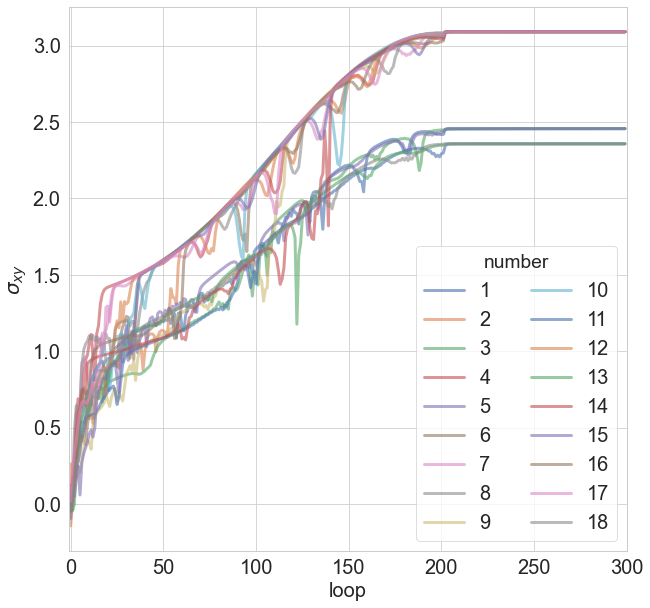

In [58]:
fig, axes = plt.subplots(1,1, figsize=(10,10), sharex=True)
ax = axes
for _ind_seed, seed in enumerate([111,222,333,444,555,666,777,888,999,1111,2222,3333,4444,5555,6666,7777,8888,9999]):
    opt_state, logger = load_results(text_condition, seed)
    ax.plot(-logger['sigma_xy'], alpha=0.6, label=f'{_ind_seed+1}')
    ax.set_xlim(-1,300)
    ax.legend(ncol=2, loc='lower right', title='number', fontsize=20)
    print(np.round(logger['chern_num'][-1], decimals=3))
ax.set_xlabel('loop', fontsize=20)
ax.set_ylabel(r'$\sigma_{xy}$', fontsize=20)
ax.tick_params(axis='x', labelsize=20)
ax.tick_params(axis='y', labelsize=20)

fig.savefig("figure/sup_triangular_sigma.pdf", format='pdf')
plt.show()

### Band structure

In [59]:
text_condition = f'triangular'
seed = 222
opt_state, logger = load_results(text_condition, seed)
boundaries = [200]
values = [0.1,0.03]
func_step_size = optimizers.piecewise_constant(boundaries, values)
opt_init, opt_update, get_params = optimizers.rmsprop(func_step_size, gamma=0.99)
params = get_params(opt_state)

In [60]:
beta = jnp.array(200)
delta = jnp.array(0.01)
filling = jnp.array(2.0)
e,v,sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y = calc_result(beta, delta, opt_state, k, from_d, to_d, allow_d, t_cond, filling)
print(sigma_xy.sum().real/n_k/n_k, chern_num, n_fill, mu)
t_res = calc_t(get_params(opt_state), t_cond)

5.999986960872466 [ 4.99998311  1.00000385 -2.99998775 -2.99999922] 1.9999999999999987 -1.8748884940698995


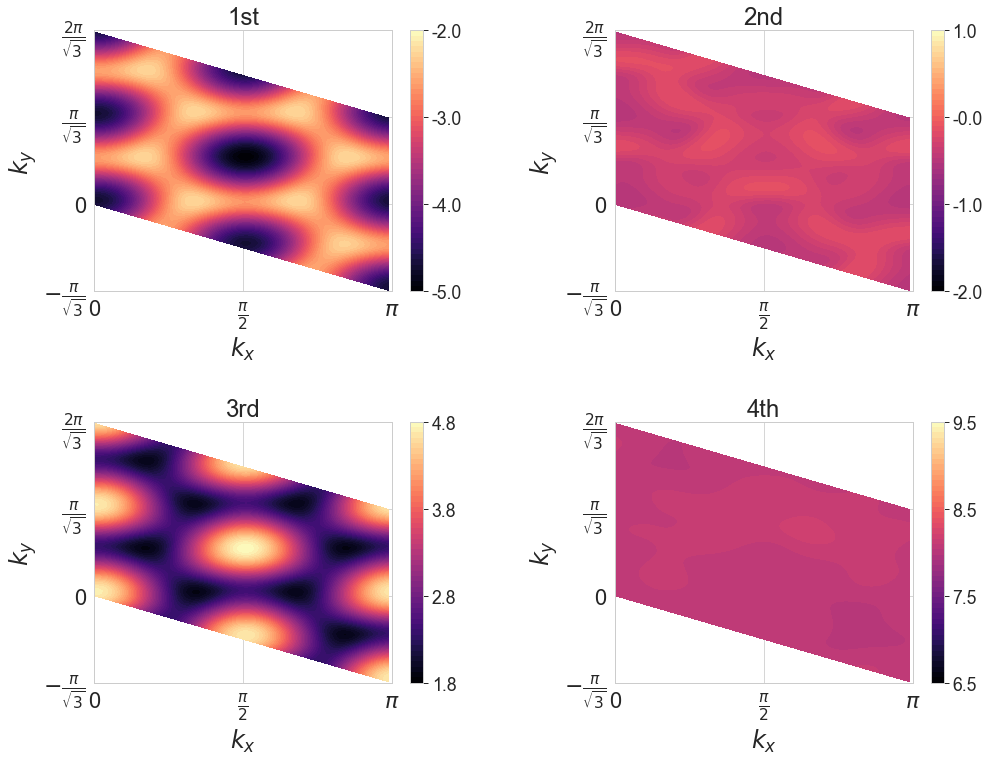

In [61]:
fig = plt.figure(figsize=(16, 12))
ax = fig.add_subplot(221)
plt.subplots_adjust(wspace=0.4, hspace=0.5)

_fsize = 24

def common_feature(ax):
    ax.set_xlabel(r'$k_x$', fontsize=_fsize)
    ax.set_ylabel(r'$k_y$', fontsize=_fsize)
    ax.set_xticks([0, np.pi/2, np.pi])
    ax.set_xticklabels(['0', r'$\frac{\pi}{2}$', r'$\pi$'], fontsize=22)
    ax.set_yticks([-np.pi/np.sqrt(3), 0, np.pi/np.sqrt(3), 2*np.pi/np.sqrt(3)])
    ax.set_yticklabels([r'$-\frac{\pi}{\sqrt{3}}$', '0', r'$\frac{\pi}{\sqrt{3}}$', r'$\frac{2\pi}{\sqrt{3}}$'], fontsize=22)

cmap = 'magma'
levels = 50

vwidth = 3.0
vmin = -5.0
vmax = vmin+vwidth
levels = np.linspace(vmin,vmax, 50)
cs = ax.contourf(k[:,:,0], k[:,:,1], e[:,:,0]-mu, levels=levels, cmap=cmap, vmin=-5, vmax=-2)
ax.set_title('1st', fontsize=_fsize)
cax = fig.colorbar(cs, ax=ax, ticks=[-5.0,-4.0,-3.0,-2.0])
cax.ax.set_yticklabels(["-5.0","-4.0","-3.0","-2.0"])
common_feature(ax)


vmin = -2.0
vmax = vmin+vwidth
ax = fig.add_subplot(222)
levels = np.linspace(vmin,vmax, 50)

cs = ax.contourf(k[:,:,0], k[:,:,1], e[:,:,1]-mu, levels=levels, cmap=cmap, vmin=vmin, vmax=vmax)
ax.set_title('2nd', fontsize=_fsize)
cax = fig.colorbar(cs, ax=ax, ticks=[-2.0,-1.0, 0.0, 1.0])
common_feature(ax)
cax.ax.set_yticklabels(["-2.0","-1.0","-0.0","1.0"])



vmin = 1.8
vmax = vmin+vwidth
levels = np.linspace(vmin,vmax, 50)

ax = fig.add_subplot(223)
cs = ax.contourf(k[:,:,0], k[:,:,1], e[:,:,2]-mu, levels=levels, cmap=cmap, vmin=vmin, vmax=vmax)
ax.set_title('3rd', fontsize=_fsize)
cax = fig.colorbar(cs, ax=ax, ticks=[1.8, 2.8, 3.8, 4.8])
cax.ax.set_yticklabels(["1.8","2.8","3.8","4.8"])
common_feature(ax)


vmin = 6.5
vmax = vmin+vwidth
levels = np.linspace(vmin,vmax, 50)

ax = fig.add_subplot(224)
cs = ax.contourf(k[:,:,0], k[:,:,1], e[:,:,3]-mu, levels=levels, cmap=cmap, vmin=vmin, vmax=vmax)
ax.set_title('4th', fontsize=_fsize)
cax = fig.colorbar(cs, ax=ax, ticks=[6.5, 7.5, 8.5, 9.5])
cax.ax.set_yticklabels(["6.5","7.5","8.5","9.5"])
common_feature(ax)


fig.savefig("figure/sup_triangular_band.pdf", format='pdf')
plt.show()

### Refinement of the model parameters

In [62]:
a0 = a[0]
a1 = a[1]
a2 = a[1] - a[0]

_n = 20
_ar = np.arange(-_n/2,_n/2)
_ar1, _ar2 = np.meshgrid(_ar,_ar)
Rs = R[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + R[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
Rs = Rs.reshape(-1,2)

points = a[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + a[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
points = points.reshape(-1,2)

In [63]:
text_condition = f'triangular'
seed = 222
opt_state, logger = load_results(text_condition, seed)

filling = jnp.array(2.0)
boundaries = [200]
values = [0.1,0.03]
func_step_size = optimizers.piecewise_constant(boundaries, values)
opt_init, opt_update, get_params = optimizers.rmsprop(func_step_size, gamma=0.99)
params = get_params(opt_state)

beta = jnp.array(200)
delta = jnp.array(0.01)
e,v,sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y = calc_result(beta, delta, opt_state, k, from_d, to_d, allow_d, t_cond, filling)
print(sigma_xy.sum().real/n_k/n_k, chern_num, n_fill, mu)
t_res = calc_t(get_params(opt_state), t_cond)


# k空間のシフトをして対称点がΓ点にくるように。
idx_min = jnp.unravel_index(jnp.argmin(e[:,:,0]), e[:,:,0].shape)
t_res_shift = jnp.exp(-jnp.dot(allow_d, k[idx_min[0],idx_min[1]])*1j) * t_res

# 8分割した位相のどれか一番近いものに変えてしまう

N_p = 4
p_cand = jnp.linspace(-1,1,N_p*2+1, endpoint=True)
angle_estim = np.array([p_cand[jnp.abs(p_cand-_p).argmin()] for _p in jnp.angle(t_res_shift[4:])/jnp.pi])

t_res_simple = jnp.concatenate([t_res_shift[:4], jnp.exp(1j*angle_estim*jnp.pi)])
param_simple = jnp.concatenate([jnp.array([10.0,10.0]), jnp.angle(t_res_simple[4:])])
opt_state_simple = opt_init(param_simple)

e,v,sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y = calc_result(beta, delta, opt_state_simple, k, from_d, to_d, allow_d, t_cond, filling)
print(sigma_xy.sum().real/n_k/n_k, chern_num, n_fill, mu)


# t2の三角形がずれているので手で修正
angle_estim = np.array([p_cand[jnp.abs(p_cand-_p).argmin()] for _p in jnp.angle(t_res_shift[4:])/jnp.pi])
angle_estim[13] = -0.25

t_res_simple = jnp.concatenate([t_res_shift[:4], jnp.exp(1j*angle_estim*jnp.pi)])
param_simple = jnp.concatenate([jnp.array([10.0,10.0]), jnp.angle(t_res_simple[4:])])
opt_state_simple = opt_init(param_simple)

e,v,sigma_xy, chern_num, n_fill, mu, omegaz, a_x, a_y = calc_result(beta, delta, opt_state_simple, k, from_d, to_d, allow_d, t_cond, filling)
print(sigma_xy.sum().real/n_k/n_k, chern_num, n_fill, mu)

t_res = t_res_simple

5.999986960872466 [ 4.99998311  1.00000385 -2.99998775 -2.99999922] 1.9999999999999987 -1.8748884940698995
5.999858918235231 [ 4.99995026  0.99990866 -2.99985987 -2.99999905] 1.9999999999999998 -0.9039878992422051
5.999956918550882 [ 4.999922    1.00003492 -2.99995789 -2.99999903] 1.9999999999999998 -0.9660030606893055


In [64]:
tri_res = get_phase_tri(dic_idx_tri, t_res_simple)


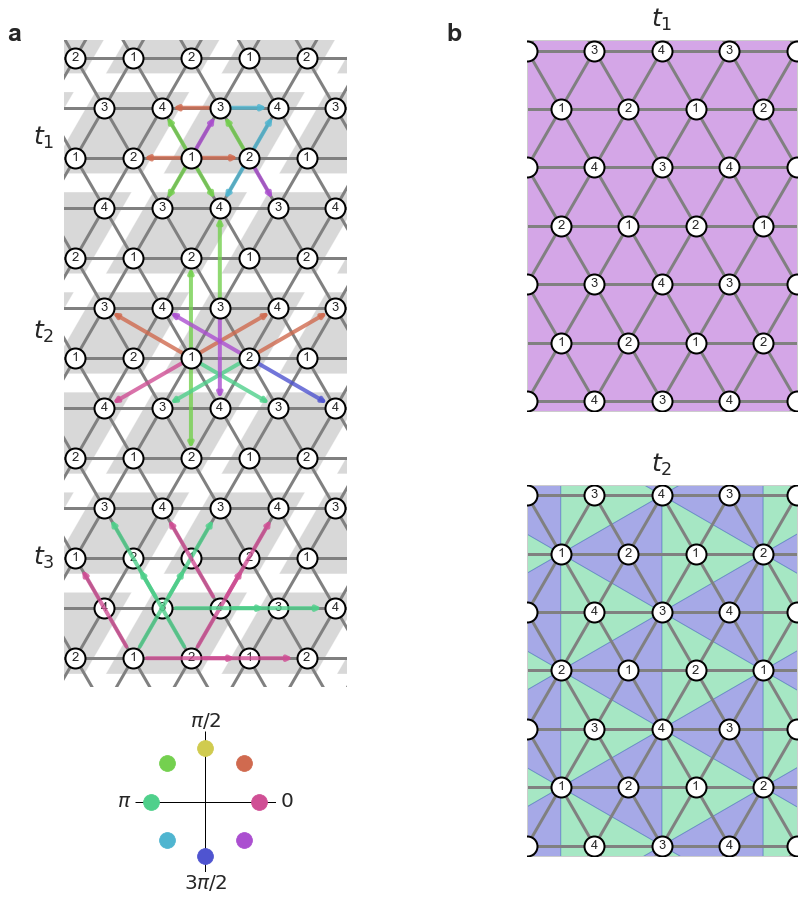

In [65]:
figure = plt.figure(figsize=(15, 15))
gs_master = GridSpec(nrows=5, ncols=2, height_ratios=[1,1,1,1,1], width_ratios=[1.0,1.0], hspace=0.2, wspace=0.2)

_x_fig_ind, _y_fig_ind = -0.20, 1.00


#################################################################################################################


gs_2 = GridSpecFromSubplotSpec(nrows=5, ncols=1, subplot_spec=gs_master[0:5, 0:1], hspace=0.2)
ax = figure.add_subplot(gs_2[0:4, :])
ax.set_aspect('equal')


ax.text(_x_fig_ind, 1+(_y_fig_ind-1)/3, "a", transform=ax.transAxes, weight='bold', fontsize=25)

a0 = a[0]
a1 = a[1]
a2 = a[1] - a[0]

_n = 20
_ar = np.arange(-_n/2,_n/2)
_ar1, _ar2 = np.meshgrid(_ar,_ar)
points = a[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + a[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
points = points.reshape(-1,2)

for j in range(-10,10):
    ax.plot(np.array([-a0[0],a0[0]])*10+a1[0]*j, np.array([-a0[1],a0[1]])*10+a1[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a1[0],a1[0]])*10+a0[0]*j, np.array([-a1[1],a1[1]])*10+a0[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a2[0],a2[0]])*10+a0[0]*j, np.array([-a2[1],a2[1]])*10+a0[1]*j, c='gray', zorder=1)
ax.scatter(points[:,0], points[:,1], c='white', edgecolors='black', linewidths=2,  s=400, zorder=3)

x_min, x_max = -3-0.2, 1.5+0.2
y_min, y_max = -4*np.sqrt(3)-0.5, 2*np.sqrt(3)+0.3

for R_i in Rs:
    for _i in range(4):
        if (x_min < R_i[0]+sub[_i,0] < x_max) and (y_min < R_i[1]+sub[_i,1] < y_max):
            ax.text(R_i[0]+sub[_i,0], R_i[1]+sub[_i,1], f'{_i+1}', horizontalalignment='center', verticalalignment='center', in_layout=False, size=13)

    
R_t1 = -R[0] + R[1]
for fd_i, td_i, ad_i, t_i in zip(from_d1, to_d1, allow_d1, t_res[4:4+12]):
    t_i_phase = jnp.angle(t_i)/jnp.pi*0.5+0.5 # [0,1]
    ax.annotate("", xy=R_t1+sub[fd_i]+ad_i*0.85, xytext=R_t1+sub[fd_i]+ad_i*0.15, 
                arrowprops=dict(arrowstyle="->",color=[*colorsys.hsv_to_rgb((t_i_phase.item()+c_h+0.25)%1.0, c_s, c_v)], lw=4, alpha=0.8), zorder=2)

R_t2 = -R[1]
for fd_i, td_i, ad_i, t_i in zip(from_d2, to_d2, allow_d2, t_res[4+12:4+12*2]):
    t_i_phase = jnp.angle(t_i)/jnp.pi*0.5+0.5 # [0,1]
    ax.annotate("", xy=R_t2+sub[fd_i]+ad_i*0.925, xytext=R_t2+sub[fd_i]+ad_i*0.075, 
                arrowprops=dict(arrowstyle="->",color=[*colorsys.hsv_to_rgb((t_i_phase.item()+c_h+0.25)%1.0, c_s, c_v)], lw=4, alpha=0.8), zorder=2)

R_t3 = 1*R[0]-4*R[1]
for fd_i, td_i, ad_i, t_i in zip(from_d3, to_d3, allow_d3, t_res[4+12*2:4+12*3]):
    t_i_phase = jnp.angle(t_i)/jnp.pi*0.5+0.5 # [0,1]
    ax.annotate("", xy=R_t3+sub[fd_i]+ad_i*0.9, xytext=R_t3+sub[fd_i]+ad_i*0.1, 
                arrowprops=dict(arrowstyle="->",color=[*colorsys.hsv_to_rgb((t_i_phase.item()+c_h+0.25)%1.0, c_s, c_v)], lw=4, alpha=0.8), zorder=4)

def s_wid(sub_i):
    s_mean = sub.mean(axis=0)
    wid = 0.63
    return sub_i+wid*(sub_i-s_mean)
for R_i in Rs:
    p = pat.Polygon(xy = [s_wid(sub[0])+R_i,s_wid(sub[2])+R_i,s_wid(sub[3])+R_i,s_wid(sub[1])+R_i ], fc = "gray", alpha=0.3) #, ec = "black"
    ax.add_patch(p)

ax.text(-0.07, 0.85, r'$t_1$' ,horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, size=25)
ax.text(-0.07, 0.55, r'$t_2$' ,horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, size=25)
ax.text(-0.07, 0.2 , r'$t_3$' ,horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, size=25)


ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)

ax.grid(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)


ax = figure.add_subplot(gs_2[4, :])
box = ax.get_position().get_points()
box_new = box + [0.0, -0.015]
ax.set_position(Bbox(box_new))


for _i in np.arange(8):
    theta = _i/8
    color = colorsys.hsv_to_rgb((theta+c_h+0.25)%1.0, c_s, c_v)
    ax.scatter(np.cos(2*np.pi*theta), np.sin(2*np.pi*theta), c=color, s=250, zorder=2)



ax.set_xlim(-1.3,1.3)
ax.set_ylim(-1.3,1.3)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.hlines(0.0, -1.3,1.3, colors='black', lw=1, zorder=1)
ax.vlines(0.0, -1.3,1.3, colors='black', lw=1, zorder=1)
ax.axis("off")

ax.text( 1.50, 0. , r'$0$'              ,horizontalalignment='center', verticalalignment='center', size=20)
ax.text(-1.5, 0. , r'$\pi$'            ,horizontalalignment='center', verticalalignment='center', size=20)
ax.text( 0., 1.5, r'$\pi/2$'  ,horizontalalignment='center', verticalalignment='center', size=20)
ax.text( 0.,-1.5, r'$3\pi/2$' ,horizontalalignment='center', verticalalignment='center', size=20)

ax.set_xticks([0])
ax.set_xticklabels([])
ax.set_yticks([0])
ax.set_yticklabels([])

ax.set_aspect('equal')





#################################################################################################################
gs_4 = GridSpecFromSubplotSpec(nrows=2, ncols=1, subplot_spec=gs_master[:, 1:2], hspace=0.2, wspace=-0.2)
ax = figure.add_subplot(gs_4[0])
ax.set_aspect('equal')

ax.text(_x_fig_ind*1.5, _y_fig_ind, "b", transform=ax.transAxes, weight='bold', fontsize=25)

x_min, x_max = 0-0.50, 3+0.50 #-1*np.sqrt(3)-0.75, 1*np.sqrt(3)-0.25
y_min, y_max = -0.5*np.sqrt(3)-0.15, 2.5*np.sqrt(3)+0.15#-1*np.sqrt(3)-0.25, 1*np.sqrt(3)+1.25

a0 = a[0]
a1 = a[1]
a2 = a[1] - a[0]

_n = 20
_ar = np.arange(-_n/2,_n/2)
_ar1, _ar2 = np.meshgrid(_ar,_ar)
Rs = R[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + R[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
Rs = Rs.reshape(-1,2)

points = a[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + a[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
points = points.reshape(-1,2)

for j in range(-10,10):
    ax.plot(np.array([-a0[0],a0[0]])*10+a1[0]*j, np.array([-a0[1],a0[1]])*10+a1[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a1[0],a1[0]])*10+a0[0]*j, np.array([-a1[1],a1[1]])*10+a0[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a2[0],a2[0]])*10+a0[0]*j, np.array([-a2[1],a2[1]])*10+a0[1]*j, c='gray', zorder=1)
ax.scatter(points[:,0], points[:,1], c='white', edgecolors='black', linewidths=2,  s=400, zorder=3)


for R_i in Rs:
    for _i in range(4):
        if (x_min < R_i[0]+sub[_i,0] < x_max) and (y_min < R_i[1]+sub[_i,1] < y_max):
            ax.text(R_i[0]+sub[_i,0], R_i[1]+sub[_i,1], f'{_i+1}', horizontalalignment='center', verticalalignment='center', in_layout=False, size=13)
            
from_d_cat = jnp.concatenate([from_d, to_d])
allow_d_cat = jnp.concatenate([allow_d, -allow_d])

tri_res = get_phase_tri(dic_idx_tri, t_res)

for _key in ['t10', 't11']:
    idx_tri = dic_idx_tri[_key]
    d_start = sub[from_d_cat[idx_tri[:,[0]]]]
    d_cumsum = jnp.cumsum(allow_d_cat[idx_tri], axis=1)
    points_tri = jnp.concatenate([d_start, d_start + d_cumsum], axis=1)
    tri_phases = tri_res['tri_phase'][_key]
    tri_weights = tri_res['tri_weight'][_key]

    for ind, (points, tri_phase, tri_weight) in enumerate(zip(points_tri, tri_phases, tri_weights)):
        for _i1, _i2 in itertools.product([-5,-4,-3,-2,-1,0,1,2,3],repeat=2):
            xy = points+_i1*R[0]+_i2*R[1]
            p = pat.Polygon(xy=xy, closed=True, alpha=tri_weight*0.5, color=[*colorsys.hsv_to_rgb((tri_phase.item()/2/np.pi+c_h+0.25)%1.0, c_s, c_v)])
            ax.add_patch(p)

ax.set_title(r'$t_1$', fontsize=25, y=1.02)
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.grid(False)




ax = figure.add_subplot(gs_4[1])
ax.set_aspect('equal')

a0 = a[0]
a1 = a[1]
a2 = a[1] - a[0]

_n = 20
_ar = np.arange(-_n/2,_n/2)
_ar1, _ar2 = np.meshgrid(_ar,_ar)
Rs = R[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + R[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
Rs = Rs.reshape(-1,2)

points = a[0].reshape(1,1,-1)*_ar1.reshape(_n,_n,1) + a[1].reshape(1,1,-1)*_ar2.reshape(_n,_n,1)
points = points.reshape(-1,2)

for j in range(-10,10):
    ax.plot(np.array([-a0[0],a0[0]])*10+a1[0]*j, np.array([-a0[1],a0[1]])*10+a1[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a1[0],a1[0]])*10+a0[0]*j, np.array([-a1[1],a1[1]])*10+a0[1]*j, c='gray', zorder=1)
    ax.plot(np.array([-a2[0],a2[0]])*10+a0[0]*j, np.array([-a2[1],a2[1]])*10+a0[1]*j, c='gray', zorder=1)
ax.scatter(points[:,0], points[:,1], c='white', edgecolors='black', linewidths=2,  s=400, zorder=3)


R20 = 2*R[0] - R[1]
R21 = R[0] - 2*R[1]

for R_i in Rs:
    for _i in range(4):
        if (x_min < R_i[0]+sub[_i,0] < x_max) and (y_min < R_i[1]+sub[_i,1] < y_max):
            ax.text(R_i[0]+sub[_i,0], R_i[1]+sub[_i,1], f'{_i+1}', horizontalalignment='center', verticalalignment='center', in_layout=False, size=13)

for _key in ['t20', 't21']:
    idx_tri = dic_idx_tri[_key]
    d_start = sub[from_d_cat[idx_tri[:,[0]]]]
    d_cumsum = jnp.cumsum(allow_d_cat[idx_tri], axis=1)
    points_tri = jnp.concatenate([d_start, d_start + d_cumsum], axis=1)
    tri_phases = tri_res['tri_phase'][_key]
    tri_weights = tri_res['tri_weight'][_key]
    tri_shifts = jnp.array([[0.0, 0.0], [-1.0, -jnp.sqrt(3)], [-2.0, 0.0], [-1.0, -jnp.sqrt(3)]])

    for ind, (points, tri_shift, tri_phase, tri_weight) in enumerate(zip(points_tri, tri_shifts, tri_phases, tri_weights)):
        for _i1, _i2 in itertools.product([-5,-4,-3,-2,-1,0,1,2,3],repeat=2):
            xy = points+tri_shift+_i1*R20+_i2*R21
            p = pat.Polygon(xy=xy, closed=True, alpha=0.5, color=[*colorsys.hsv_to_rgb((tri_phase.item()/2/np.pi+c_h+0.25)%1.0, c_s, c_v)])
            ax.add_patch(p)

ax.set_title(r'$t_2$', fontsize=25, y=1.02)
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.grid(False)


figure.savefig("figure/sup_triangular_phase.pdf", format='pdf')
plt.show()